# Exploratory Data Analysis on Superheroes Dataset

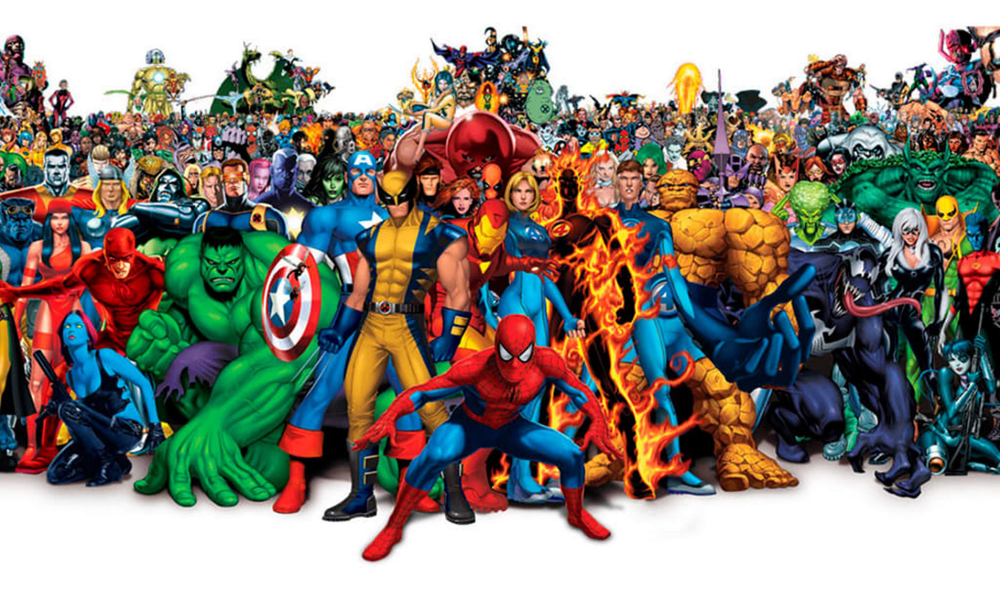

In [69]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\tiprwmhcywj03dkbpraf.jpg")

In [1]:
from wordcloud import WordCloud
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
pd.set_option('display.max_columns', None) # so that we can see all the columns
temp = pd.read_csv('D:\\Study\\EDA on Superheroes\\Cleaned_data\\cleaned_data_superheroes.csv')

sups = temp.copy()

## Top 5 rows from the dataset

In [3]:
sups.head()

,name,overall_score,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,alter_egos,aliases,place_of_birth,first_appearance,creator,alignment,occupation,base,teams,gender,type_race,height(cm),weight(lb),eye_color,hair_color,skin_color,has_electrokinesis,has_energy_constructs,has_mind_control_resistance,has_matter_manipulation,has_telepathy_resistance,has_mind_control,has_enhanced_hearing,has_dimensional_travel,has_element_control,has_size_changing,has_fire_resistance,has_fire_control,has_dexterity,has_reality_warping,has_illusions,has_energy_beams,has_peak_human_condition,has_shapeshifting,has_heat_resistance,has_jump,has_self-sustenance,has_energy_absorption,has_cold_resistance,has_magic,has_telekinesis,has_toxin_and_disease_resistance,has_telepathy,has_regeneration,has_immortality,has_teleportation,has_force_fields,has_energy_manipulation,has_endurance,has_longevity,has_weapon-based_powers,has_energy_blasts,has_enhanced_senses,has_invulnerability,has_stealth,has_marksmanship,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,6,85,30,60,60,40,70,"['Super Speed', 'Super Strength']",[],[''],Unknown,Unknown,Marvel Comics,Good,Unknown,Unknown,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True
1,514A (Gotham),10,100,20,30,50,35,100,"['Durability', 'Reflexes', 'Super Strength']","['Batgod', 'Batman', 'Batman (1966)', 'Batman ...","['Subject 514A', 'Bruce Wayne', 'Bruce 2']",Unknown,Unknown,DC Comics,Unknown,Unknown,Unknown,[],Unknown,Unknown,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,True
2,A-Bomb,20,80,100,80,100,100,80,"['Accelerated Healing', 'Agility', 'Berserk Mo...",[],['Rick Jones'],"Scarsdale, Arizona","Hulk Vol 2 #2 (April, 2008) (as A-Bomb)",Marvel Comics,Good,"Musician, adventurer, author; formerly talk sh...",Unknown,"['Teen Brigade', 'Ultimate Fantastic Four', 'U...",Male,Human,203.00,980.00,Yellow,No Hair,Unknown,False,False,False,False,True,False,False,False,False,True,True,False,False,False,False,False,False,True,True,True,True,False,True,False,False,True,False,True,False,False,False,False,True,True,False,False,True,True,True,False,False,True,False,False,True,True,True,True,True,True
3,Aa,12,80,50,55,45,100,55,"['Energy Absorption', 'Energy Armor', 'Energy ...",[],[''],Stoneworld,Green Lantern Vol 3 #21,DC Comics,Good,Unknown,Unknown,"['Blue Lantern Corps', 'Green Lantern Corps', ...",Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,True,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,Aaron Cash,5,80,10,25,40,30,50,"['Weapon-based Powers', 'Weapons Master']",[],[''],Gotham City,Unknown,DC Comics,Good,Unknown,Unknown,[],Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False


## What are the most common character names in the dataset?

In [4]:
from collections import defaultdict
import re

superhero_names = sups['name']

# Dictionary to store the frequency of common patterns
common_patterns_frequency = defaultdict(int)


def extract_common_pattern(name):
    # Remove parentheses and their contents
    name = re.sub(r'\([^)]*\)', '', name).strip()
    # Remove Roman numerals and additional symbols
    name = re.sub(r'(?:[IVXLCDM]+)(?![a-z])', '', name).strip()
    # Remove trailing spaces, hyphens, and numbers
    name = re.sub(r'[\s\-0-9]+$', '', name).strip()
    return name


for name in superhero_names:
    common_pattern = extract_common_pattern(name)
    common_patterns_frequency[common_pattern] += 1


sorted_patterns = sorted(common_patterns_frequency.items(), key=lambda x: x[1], reverse=True)


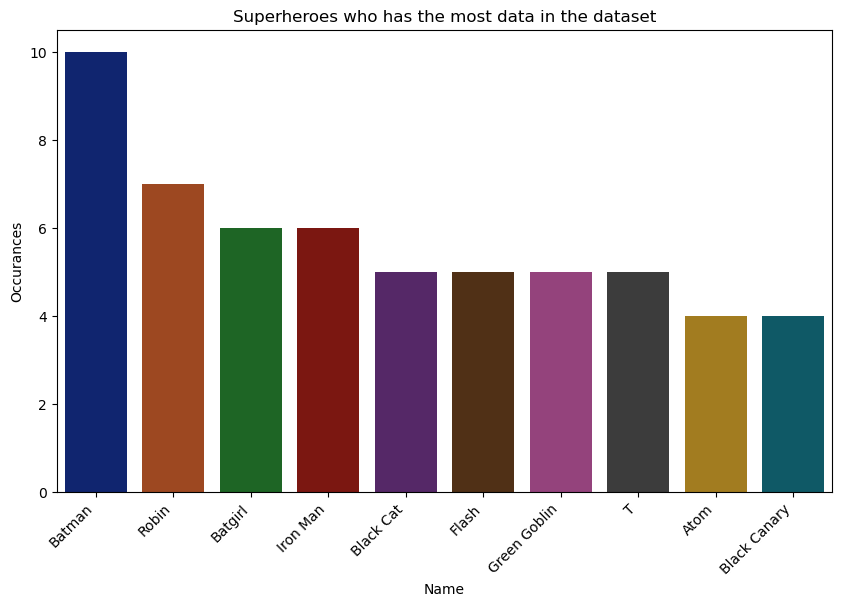

In [5]:
top_superheroes = [name for name, freq in sorted_patterns[:10]]
top_frequencies = [freq for name, freq in sorted_patterns[:10]]


# Horizontal bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x=top_superheroes, y=top_frequencies, palette='dark')
plt.xlabel('Name')
plt.ylabel('Occurances')
plt.title('Superheroes who has the most data in the dataset')
plt.xticks(rotation=45, ha='right')
plt.show()

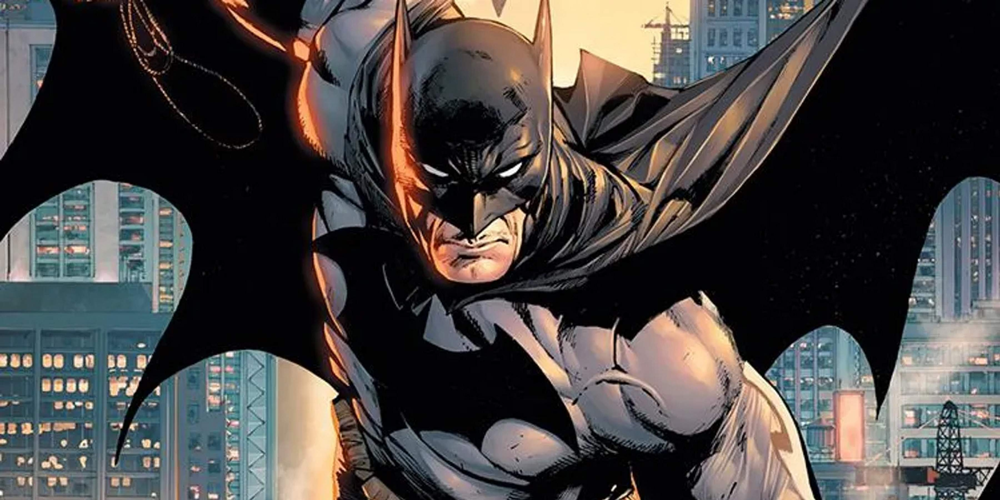

In [70]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\batman.jpg")

## Top 30 Superheroes with the most overall score

In [6]:
top_overall_score = sups.sort_values(by='overall_score',ascending=False)

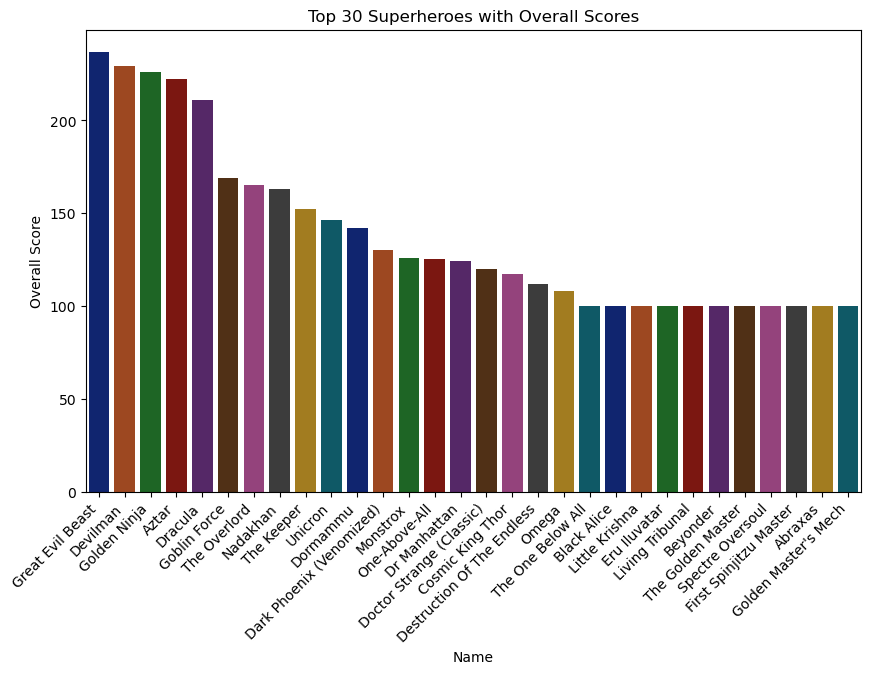

In [7]:
top_10 = top_overall_score[['name', 'overall_score']].head(30)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='overall_score', data=top_10, palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Top 30 Superheroes with Overall Scores')
plt.xticks(rotation=45, ha='right')
plt.show()


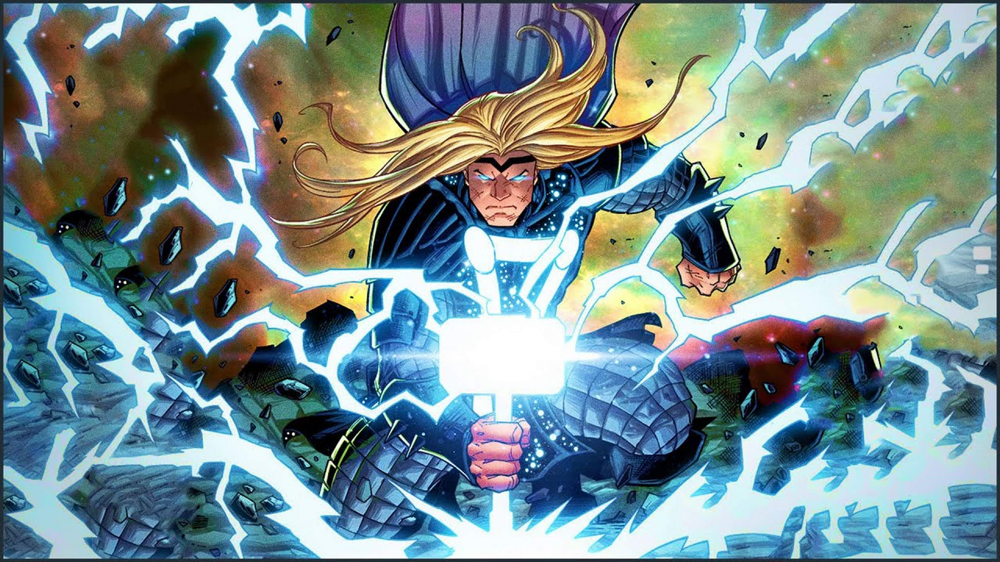

In [71]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\maxresdefault.jpg")

## Top 30 most intelligent superheroes

In [8]:
filtered_intelligence = sups[(sups['overall_score'] < sups['intelligence_score'])]


top_intelligence_score = filtered_intelligence.sort_values(by='intelligence_score', ascending=False)

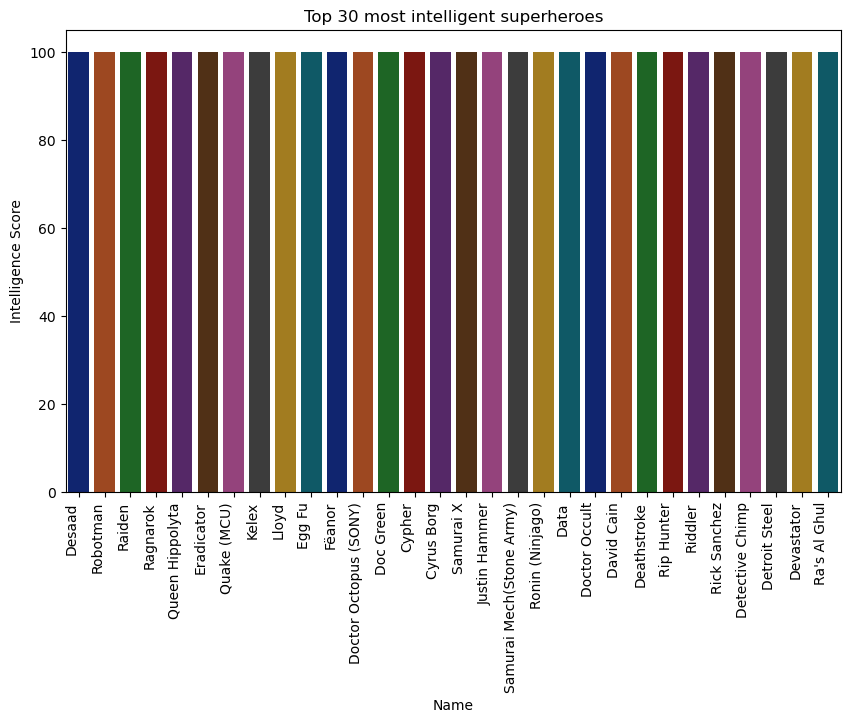

In [9]:
top_30 = top_intelligence_score[['name', 'intelligence_score']].head(30)
top_30 = top_30.sort_values(by='intelligence_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='intelligence_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Intelligence Score')
plt.title('Top 30 most intelligent superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()


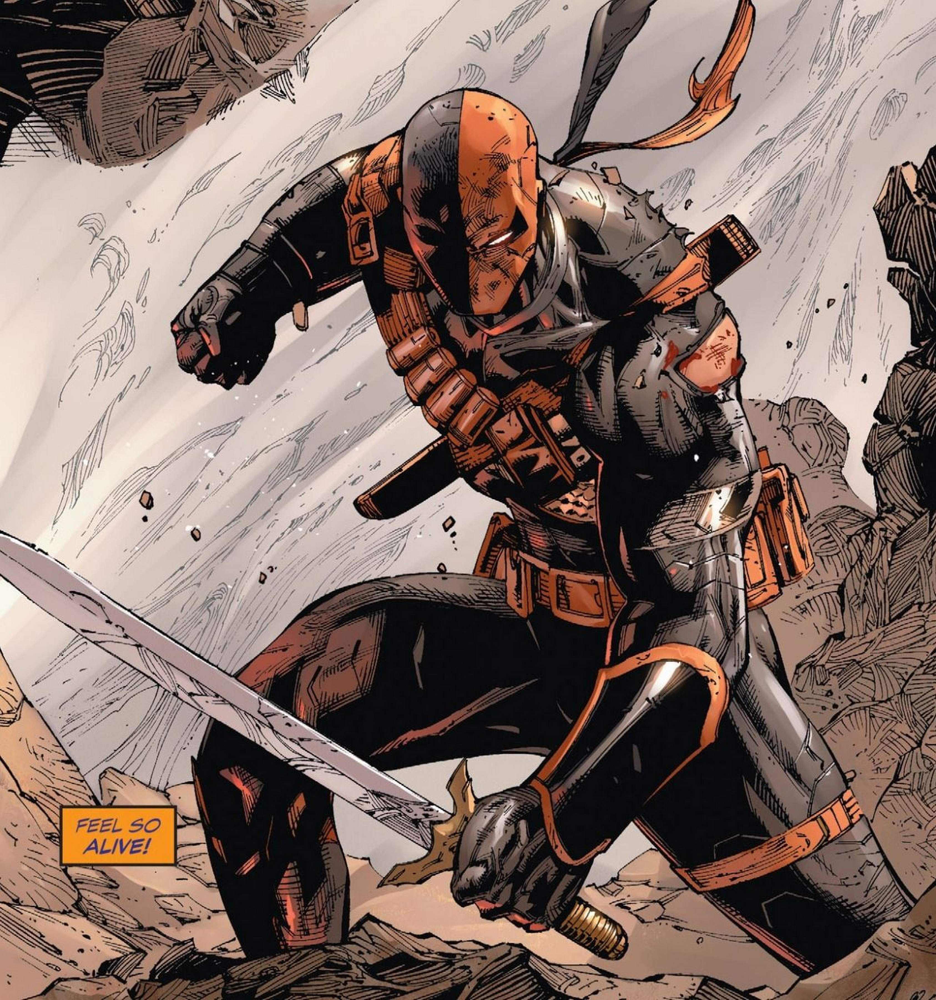

In [72]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\deathstroke.jpg")

## Top 30 Strogest Superheroes

In [10]:
filtered_strength = sups[(sups['overall_score'] < sups['strength_score'])]


top_strength_score = filtered_strength.sort_values(by='strength_score', ascending=False)

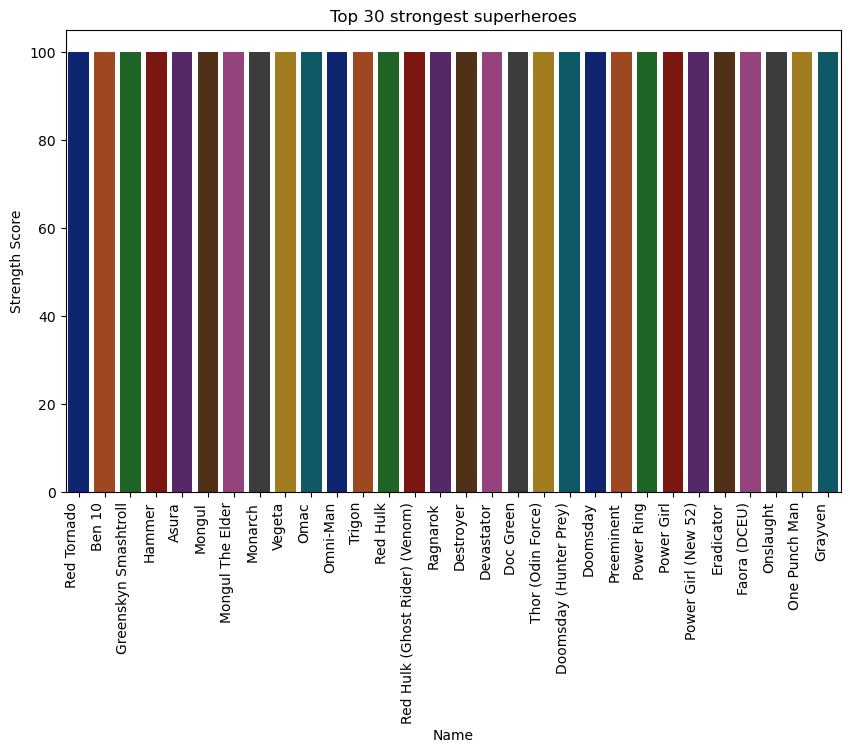

In [11]:
top_30 = top_strength_score[['name', 'strength_score']].head(30)
top_30 = top_30.sort_values(by='strength_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='strength_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Strength Score')
plt.title('Top 30 strongest superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()


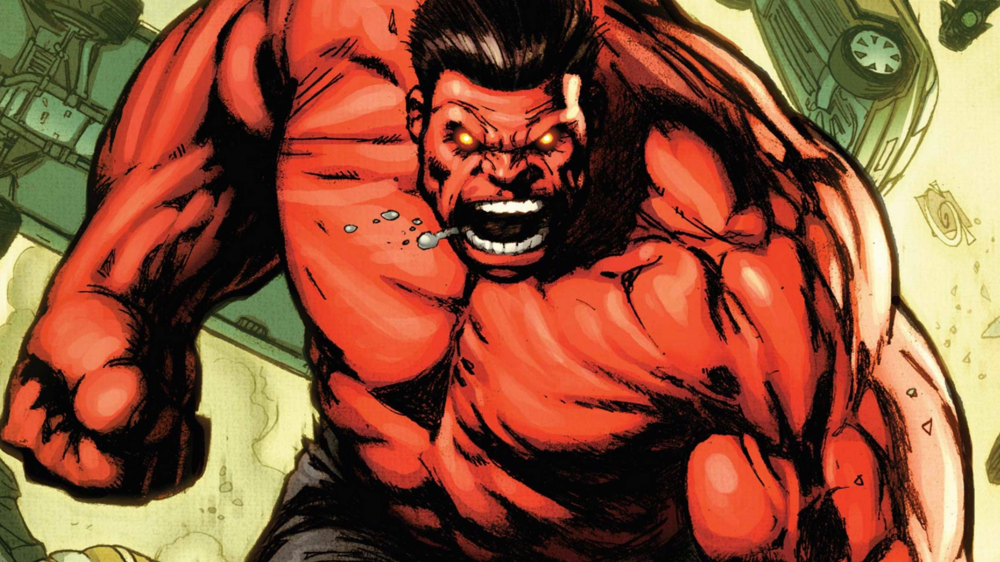

In [74]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\redhulk.jpg")

## Top 30 Speed Star

In [12]:
filtered_speed = sups[(sups['overall_score'] < sups['speed_score'])]


top_speed_score = filtered_speed.sort_values(by='speed_score', ascending=False)

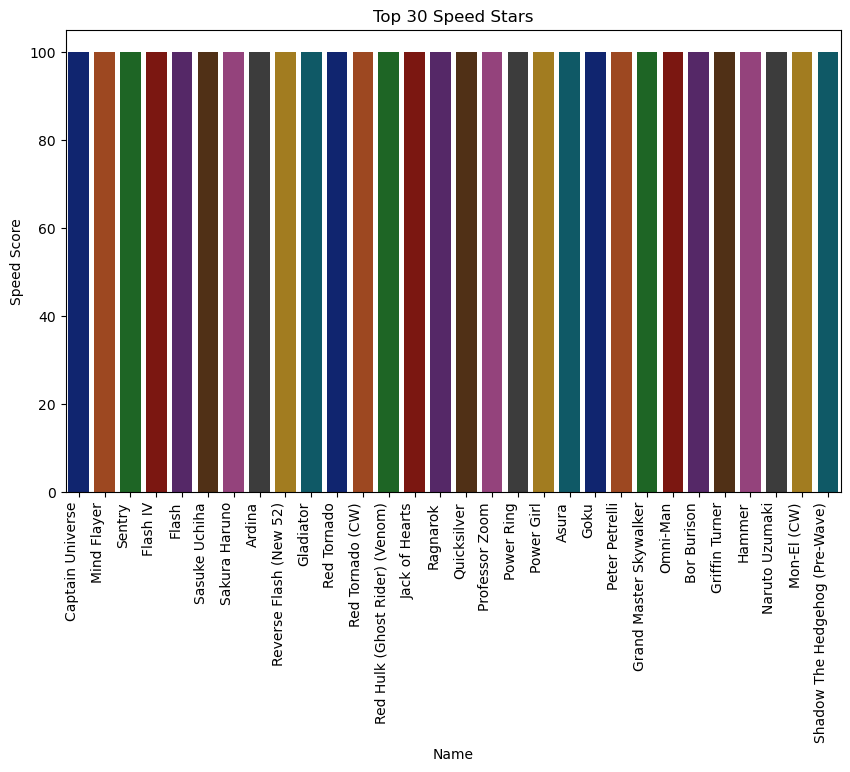

In [13]:
top_30 = top_speed_score[['name', 'speed_score']].head(30)
top_30 = top_30.sort_values(by='speed_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='speed_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Speed Score')
plt.title('Top 30 Speed Stars')
plt.xticks(rotation=90, ha='right')
plt.show()


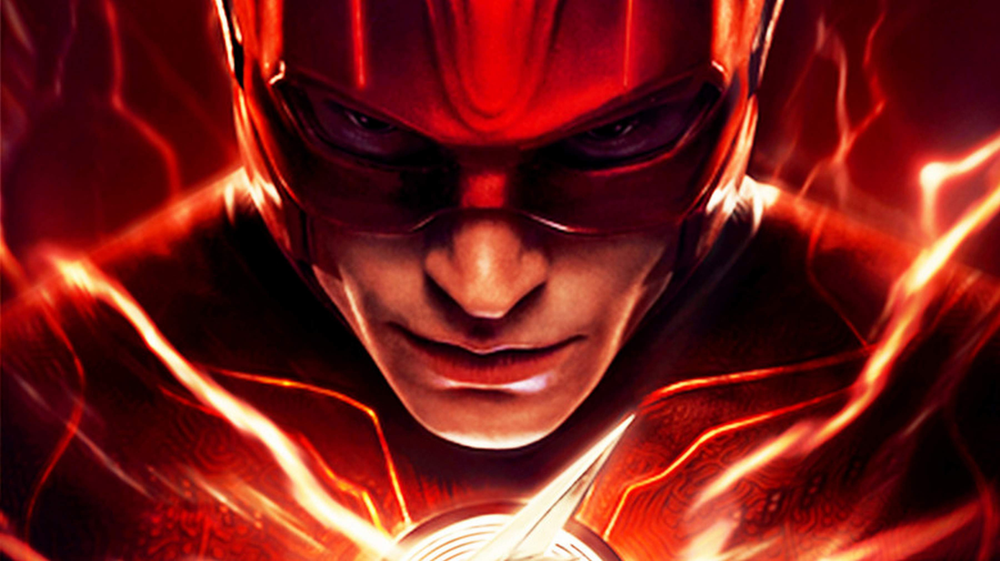

In [75]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\flash.jpg")

## Top 30 Most Durable Superheroes

In [14]:
filtered_durability = sups[(sups['overall_score'] < sups['durability_score'])]


top_durability_score = filtered_durability.sort_values(by='durability_score', ascending=False)

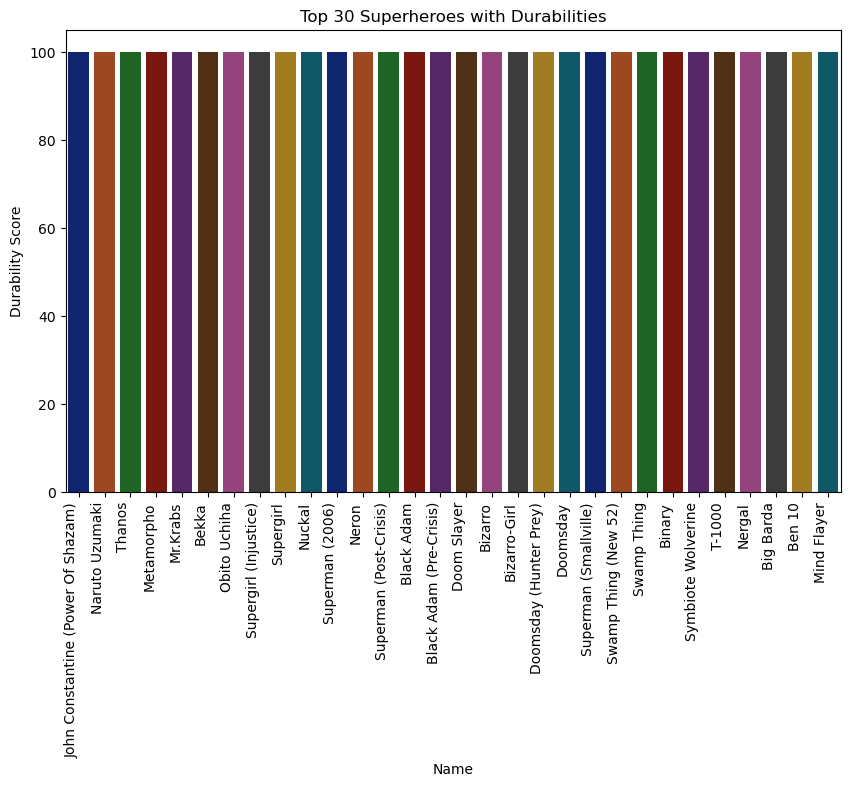

In [15]:
top_30 = top_durability_score[['name', 'durability_score']].head(30)
top_30 = top_30.sort_values(by='durability_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='durability_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Durability Score')
plt.title('Top 30 Superheroes with Durabilities')
plt.xticks(rotation=90, ha='right')
plt.show()

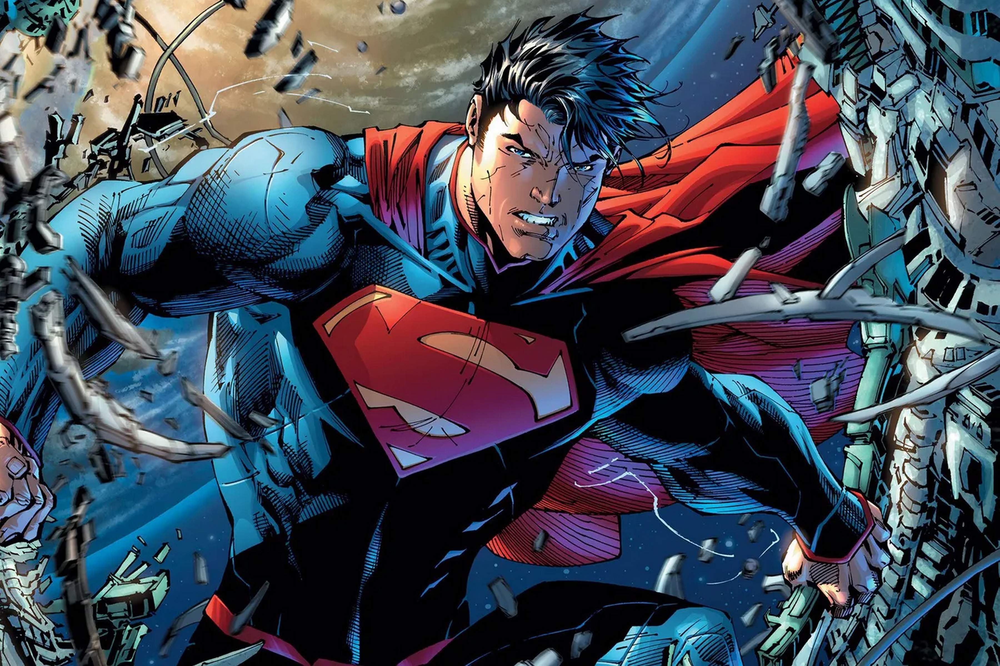

In [76]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\superman.jpg")

## Top 30 Most Powerful Superheroes

In [16]:
filtered_power = sups[(sups['overall_score'] < sups['power_score'])]


top_power_score = filtered_power.sort_values(by='power_score', ascending=False)

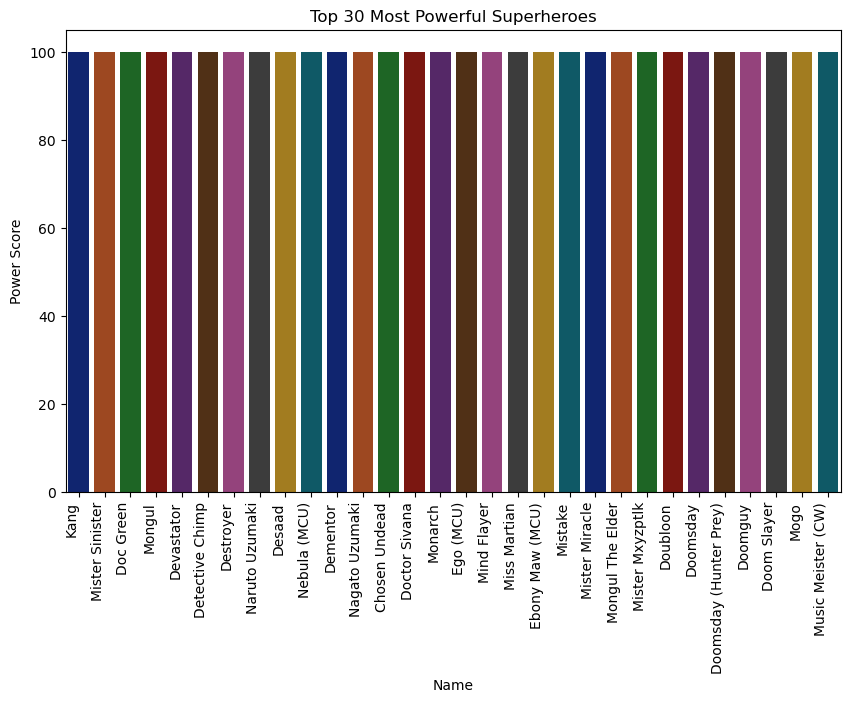

In [17]:
top_30 = top_power_score[['name', 'power_score']].head(30)
top_30 = top_30.sort_values(by='power_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='power_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Power Score')
plt.title('Top 30 Most Powerful Superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()

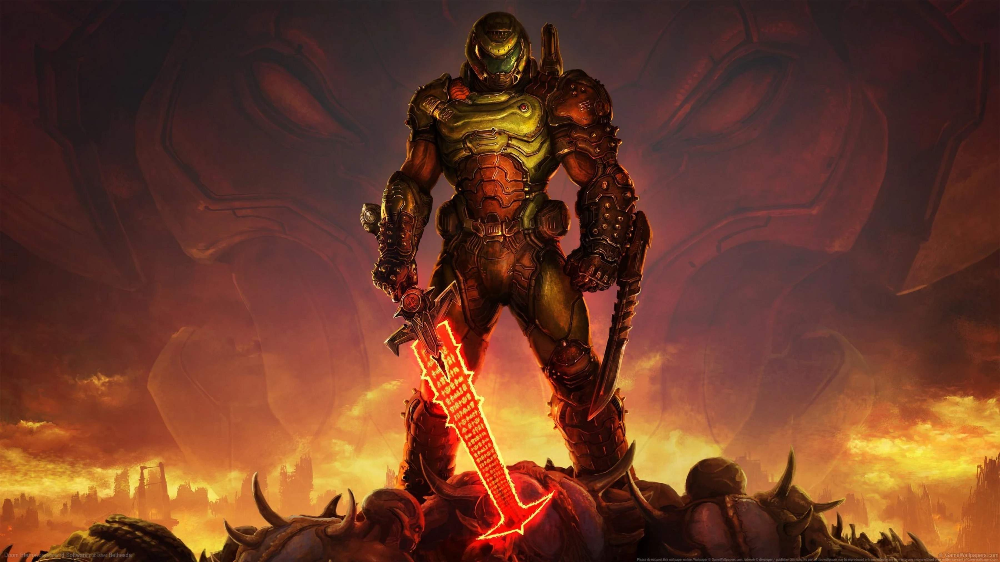

In [78]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Doom_Slayer.jpg")

## Top 30 Superheroes in terms of Combat Score

In [18]:
filtered_combat = sups[(sups['overall_score'] < sups['combat_score'])]


top_combat_score = filtered_power.sort_values(by='combat_score', ascending=False)

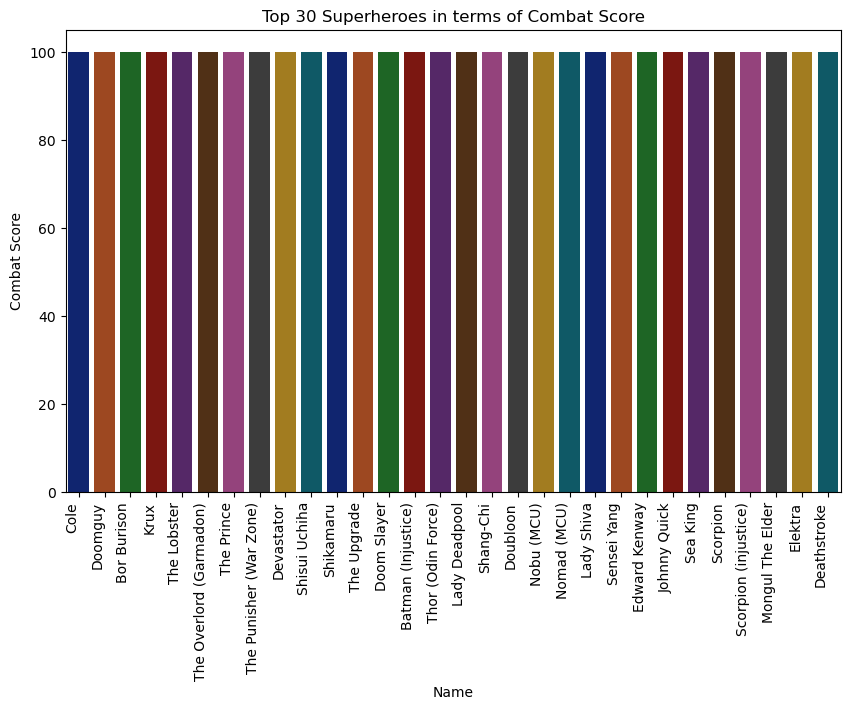

In [19]:
top_30 = top_combat_score[['name', 'combat_score']].head(30)
top_30 = top_30.sort_values(by='combat_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='combat_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Combat Score')
plt.title('Top 30 Superheroes in terms of Combat Score')
plt.xticks(rotation=90, ha='right')
plt.show()

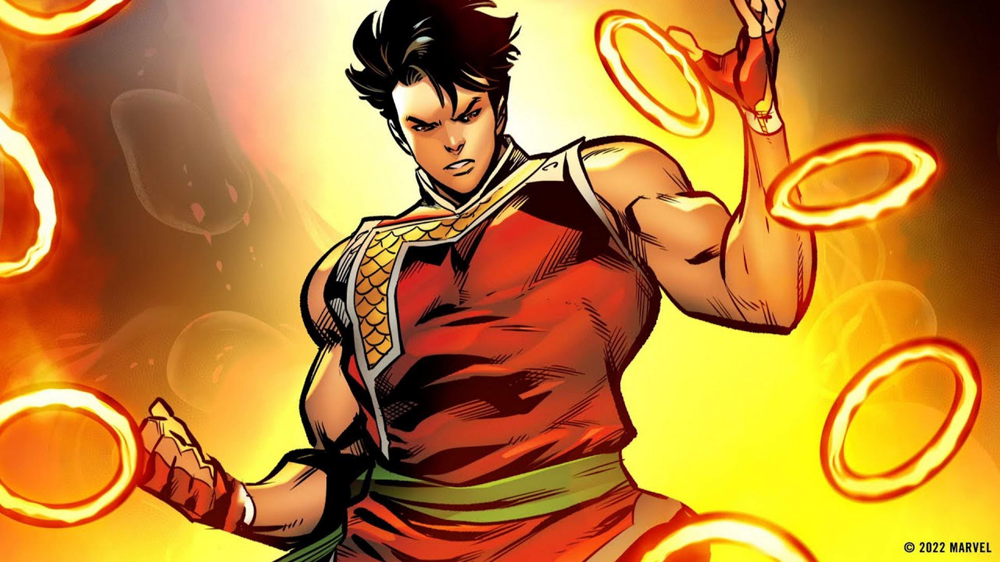

In [79]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\shangchi.jpg")

## Top 30 Superheroes Based on the number of Superpowers

In [20]:
sups['superpower_length'] = sups['superpowers'].apply(len)

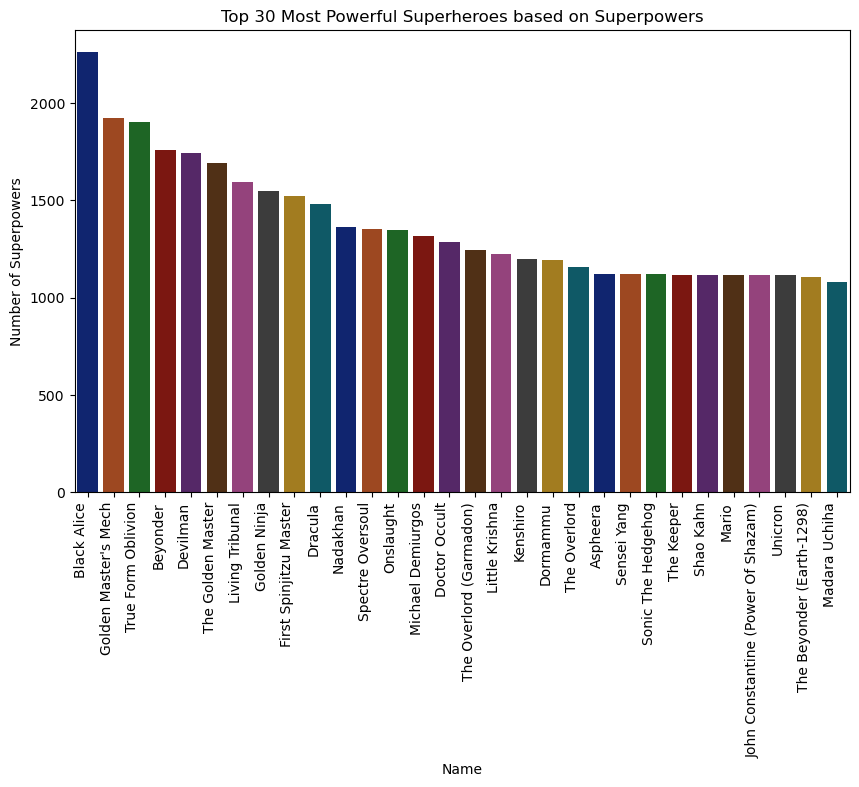

In [21]:
num_of_superpowers = sups.sort_values(by='superpower_length',ascending=False).nlargest(30,columns='superpower_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='superpower_length', data=num_of_superpowers, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Superpowers')
plt.title('Top 30 Most Powerful Superheroes based on Superpowers')
plt.xticks(rotation=90, ha='right')
plt.show()

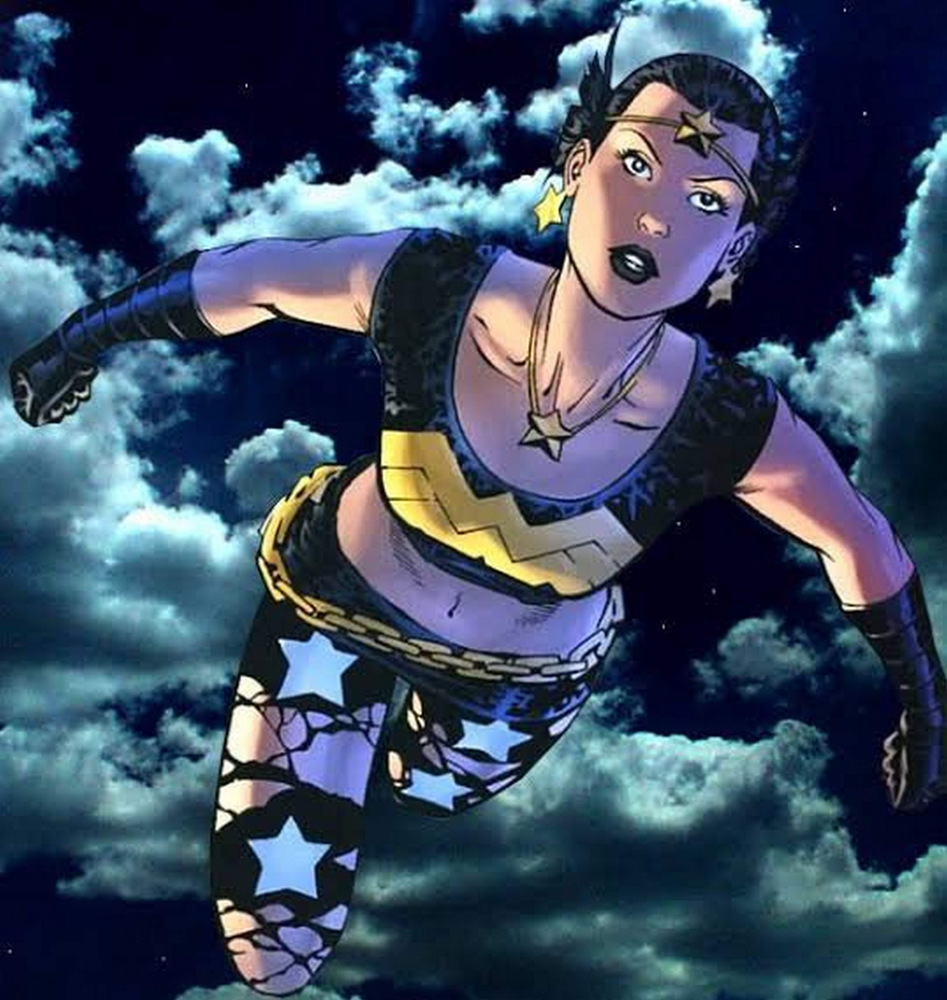

In [80]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\black-alice.jpg")

## Top 30 Superheroes with most number of Alter Egos

In [22]:
sups['alter_ego_length'] = sups['alter_egos'].apply(len)
#sups['alter_ego_length'].sort_values(ascending=False)

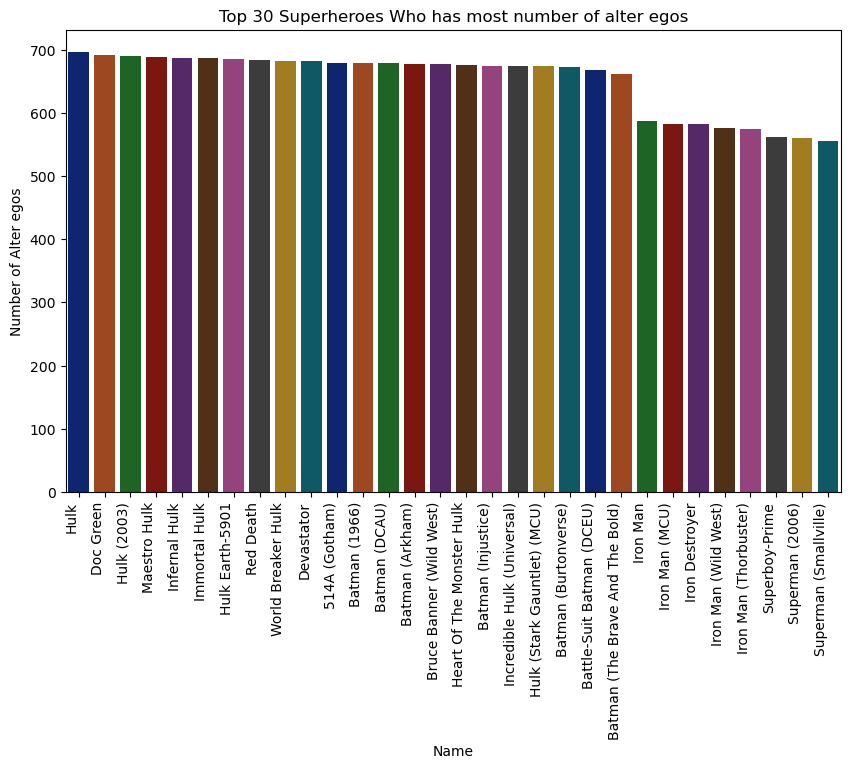

In [23]:
num_of_alter_egos = sups.sort_values(by='alter_ego_length',ascending=False).nlargest(30,columns='alter_ego_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='alter_ego_length', data=num_of_alter_egos, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Alter egos')
plt.title('Top 30 Superheroes Who has most number of alter egos')
plt.xticks(rotation=90, ha='right')
plt.show()

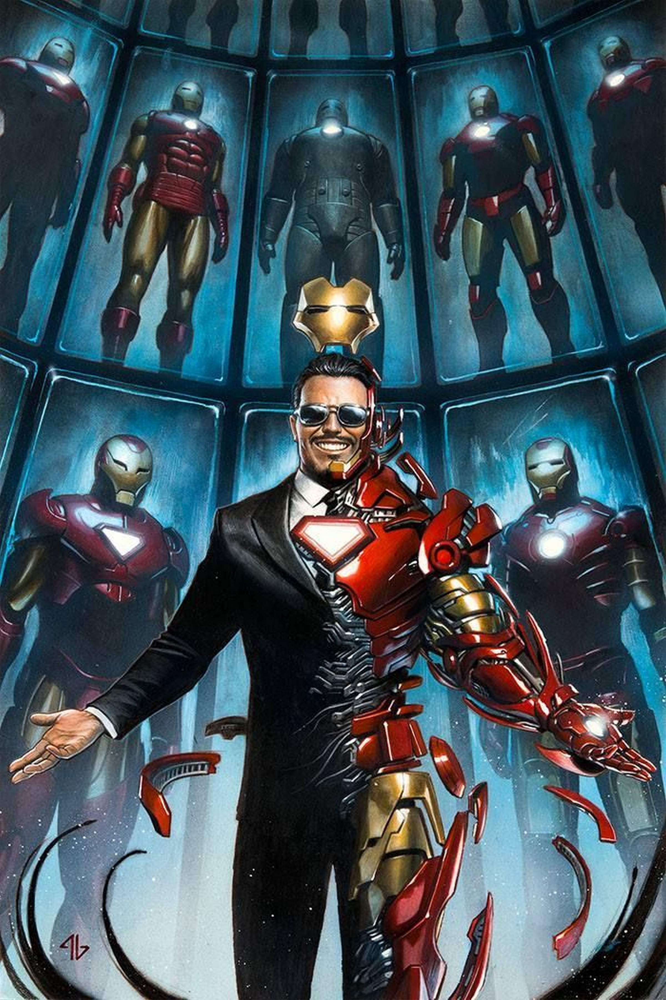

In [81]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Ironman.jpg")

## Top 30 Superheroes who has the most number of aliases

In [24]:
sups['aliases_length'] = sups['aliases'].apply(len)

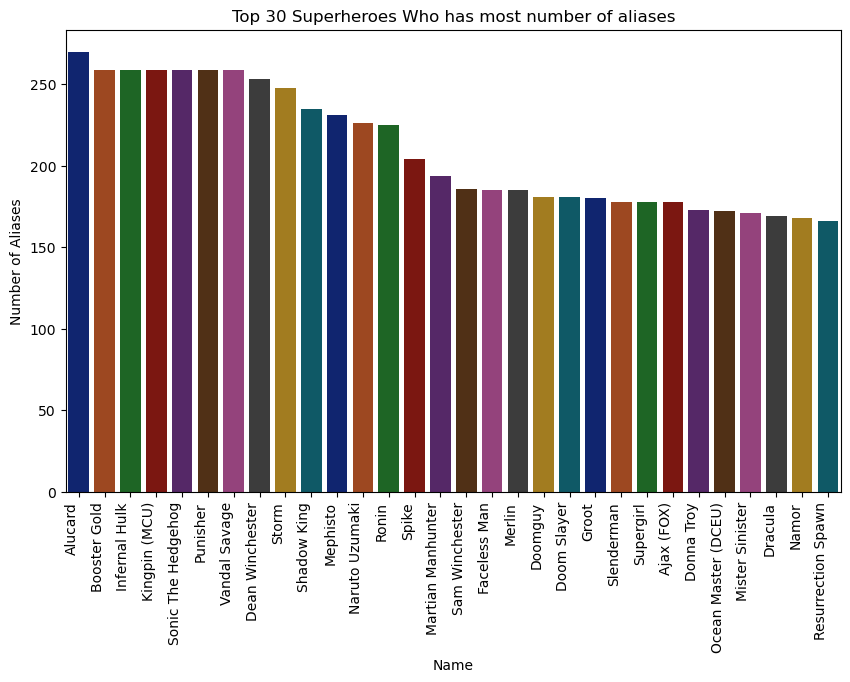

In [25]:
num_of_aliases = sups.sort_values(by='aliases_length',ascending=False).nlargest(30,columns='aliases_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='aliases_length', data=num_of_aliases, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Aliases')
plt.title('Top 30 Superheroes Who has most number of aliases')
plt.xticks(rotation=90, ha='right')
plt.show()

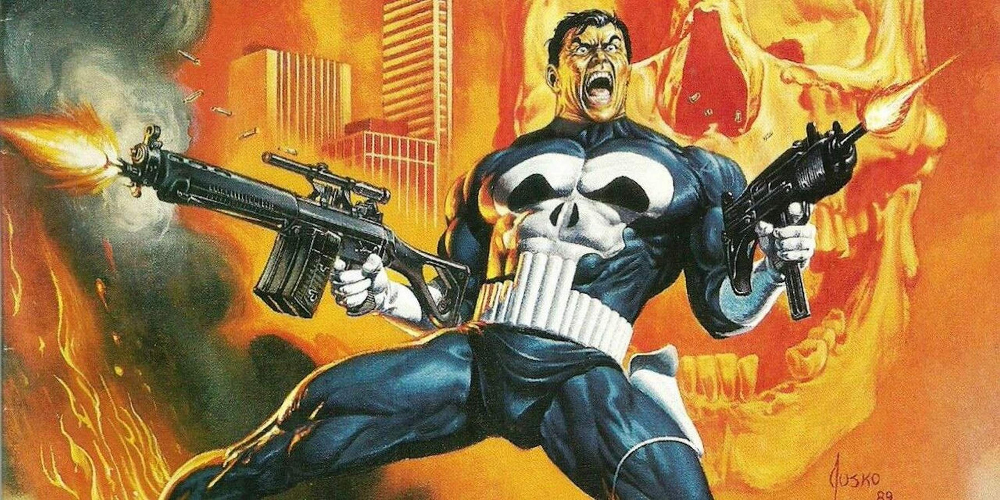

In [82]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Punisher.jpg")

## Top 30 Places Superheroes Belongs to

In [26]:
group_sizes = sups['place_of_birth'].value_counts().nlargest(30)
size_list = group_sizes.tolist()

city_names = sups['place_of_birth'].value_counts().nlargest(30).index
city_list = city_names.tolist()

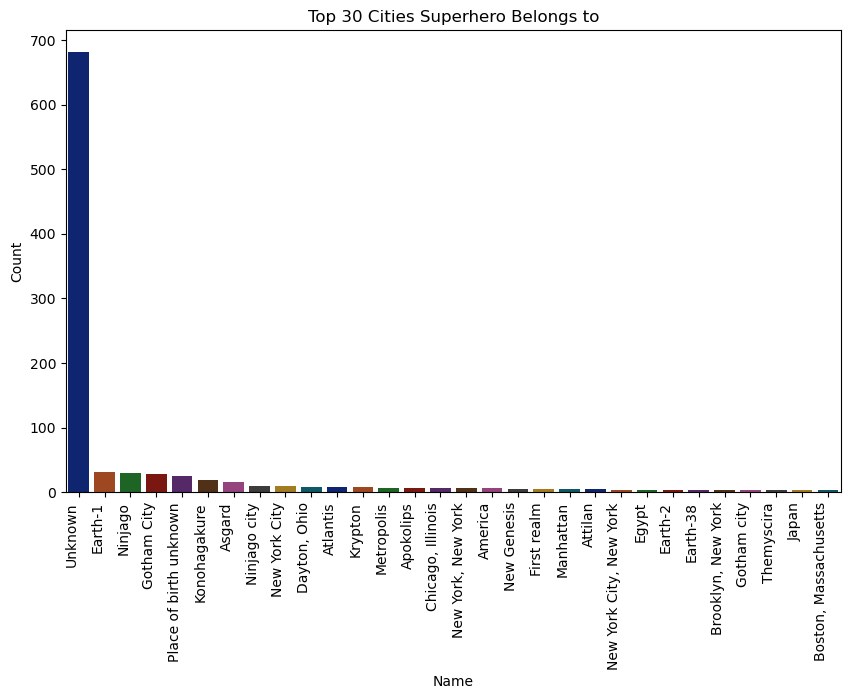

In [27]:
plt.figure(figsize=(10, 6))
sns.barplot(x=city_list, y=size_list, palette='dark')
plt.xlabel('Name')
plt.ylabel('Count')
plt.title('Top 30 Cities Superhero Belongs to')
plt.xticks(rotation=90, ha='right')
plt.show()

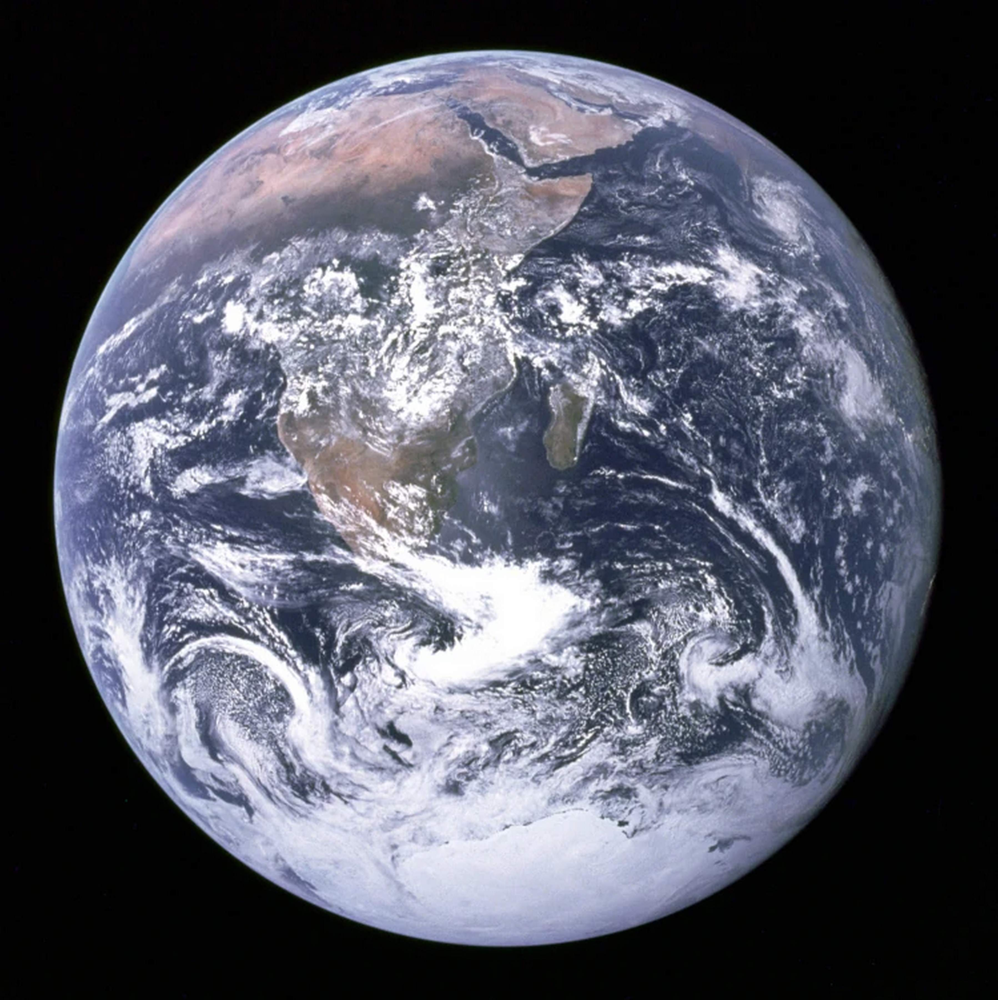

In [84]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Earth.jpg")

## TOP 30 Creators of Superheroes

In [28]:
top_30_creators = sups['creator'].value_counts().nlargest(30)

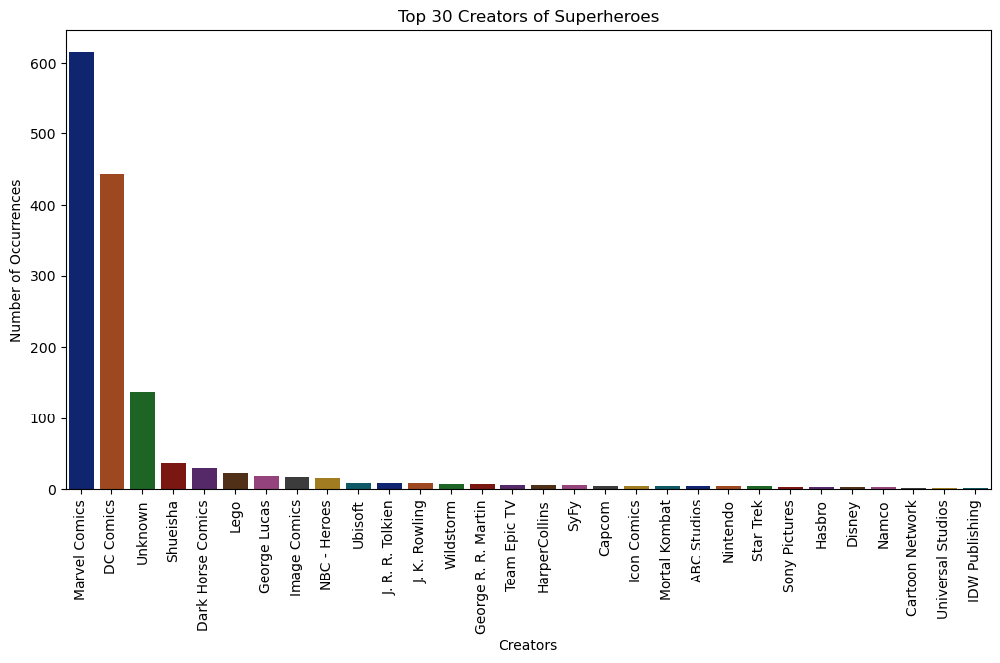

In [29]:
plt.figure(figsize=(12, 6))
sns.barplot(x=top_30_creators.index, y=top_30_creators.values, palette='dark')
plt.xlabel('Creators')
plt.ylabel('Number of Occurrences')
plt.title('Top 30 Creators of Superheroes')
plt.xticks(rotation=90)  
plt.show()


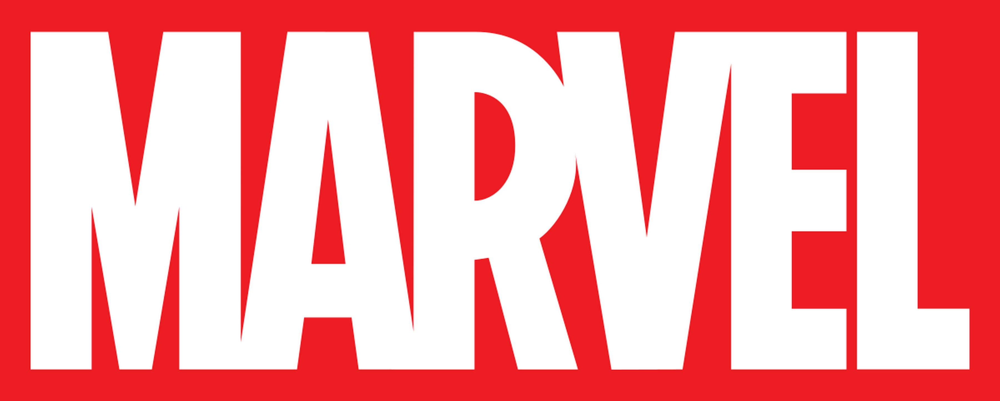

In [85]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Marvel.jpg")

## Superhero Alignment

In [30]:
alignment = sups['alignment'].value_counts().nlargest(30)

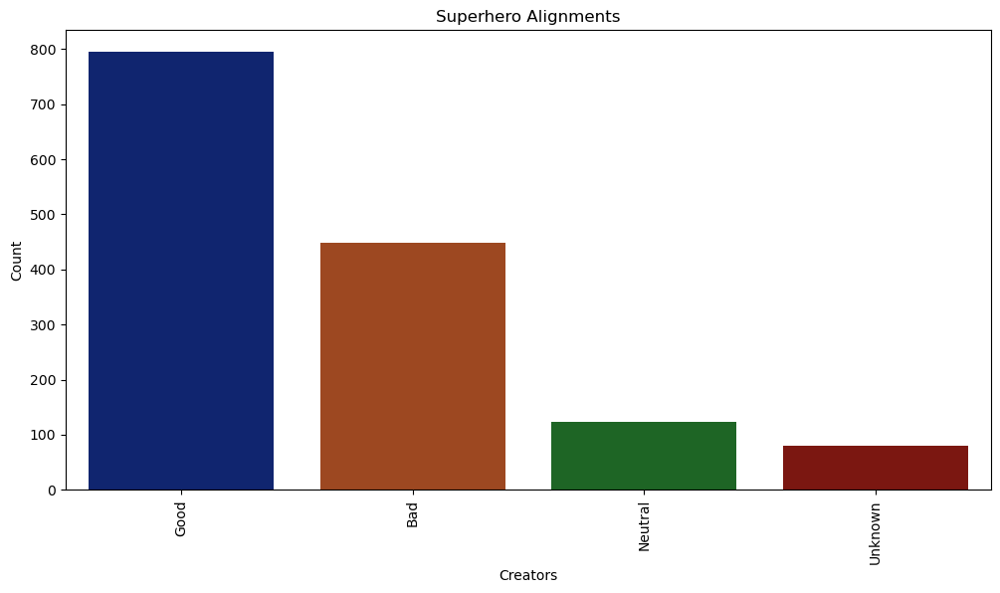

In [31]:
plt.figure(figsize=(12, 6))
sns.barplot(x=alignment.index, y=alignment.values, palette='dark')
plt.xlabel('Creators')
plt.ylabel('Count')
plt.title('Superhero Alignments')
plt.xticks(rotation=90)  
plt.show()

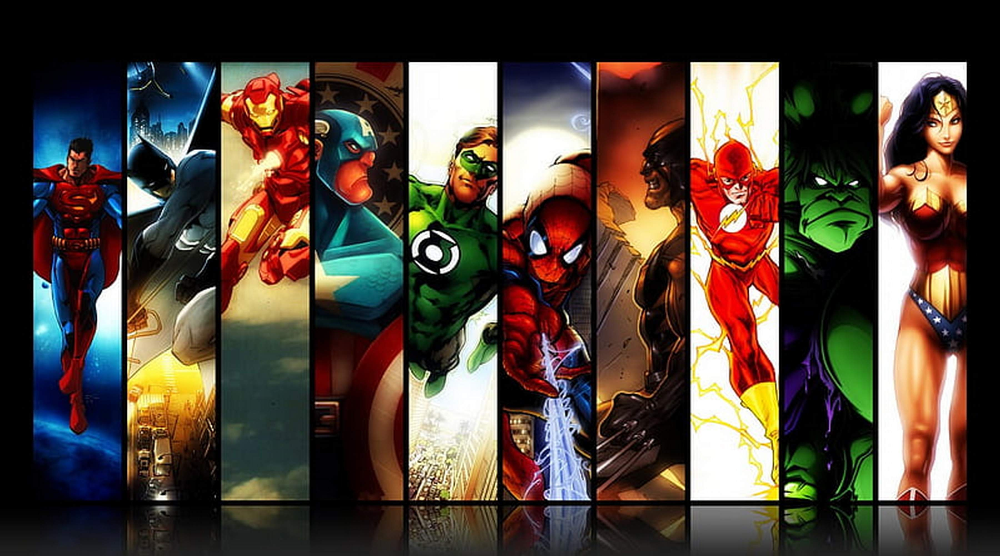

In [86]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Good_sups.jpg")

## Top 30 Real world occupations of the superheroes

In [32]:
occupations = sups['occupation'].value_counts().nlargest(30)

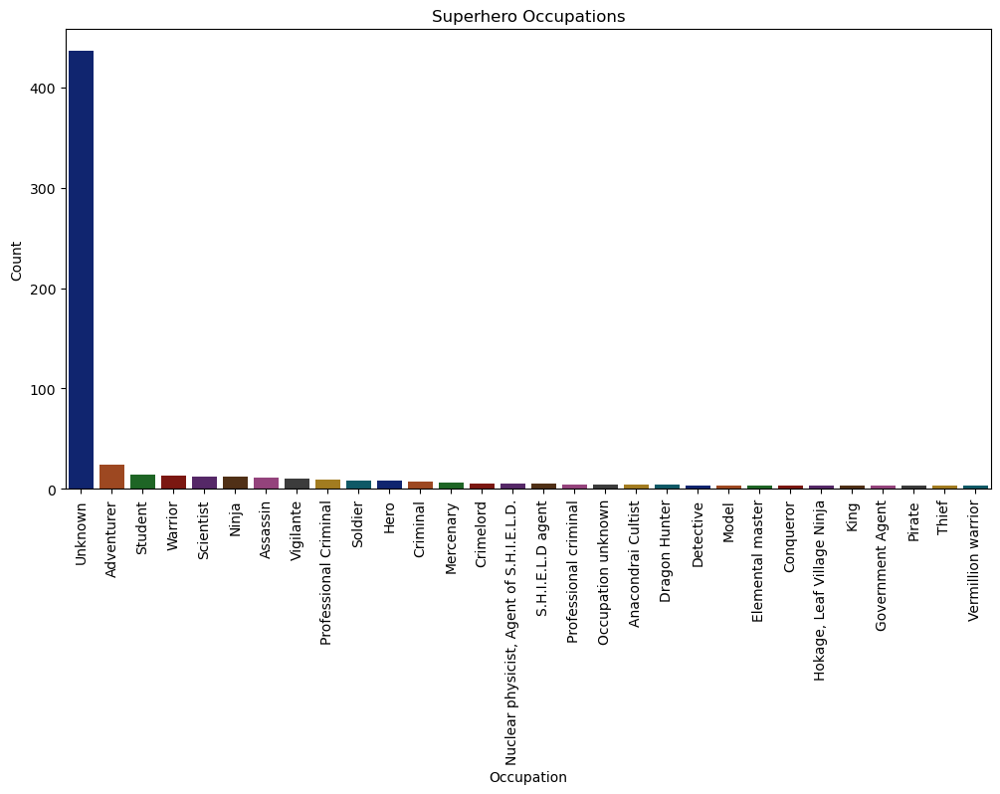

In [33]:
plt.figure(figsize=(12, 6))
sns.barplot(x=occupations.index, y=occupations.values, palette='dark')
plt.xlabel('Occupation')
plt.ylabel('Count')
plt.title('Superhero Occupations')
plt.xticks(rotation=90)  
plt.show()

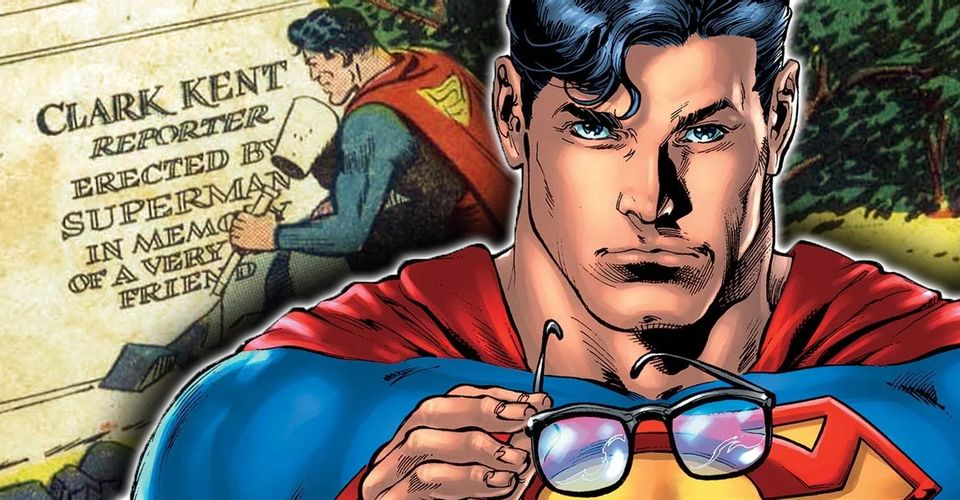

In [90]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\clerk.jpg")

## Top 30 Superhero Base

In [91]:
bases = sups['base'].value_counts().nlargest(30)

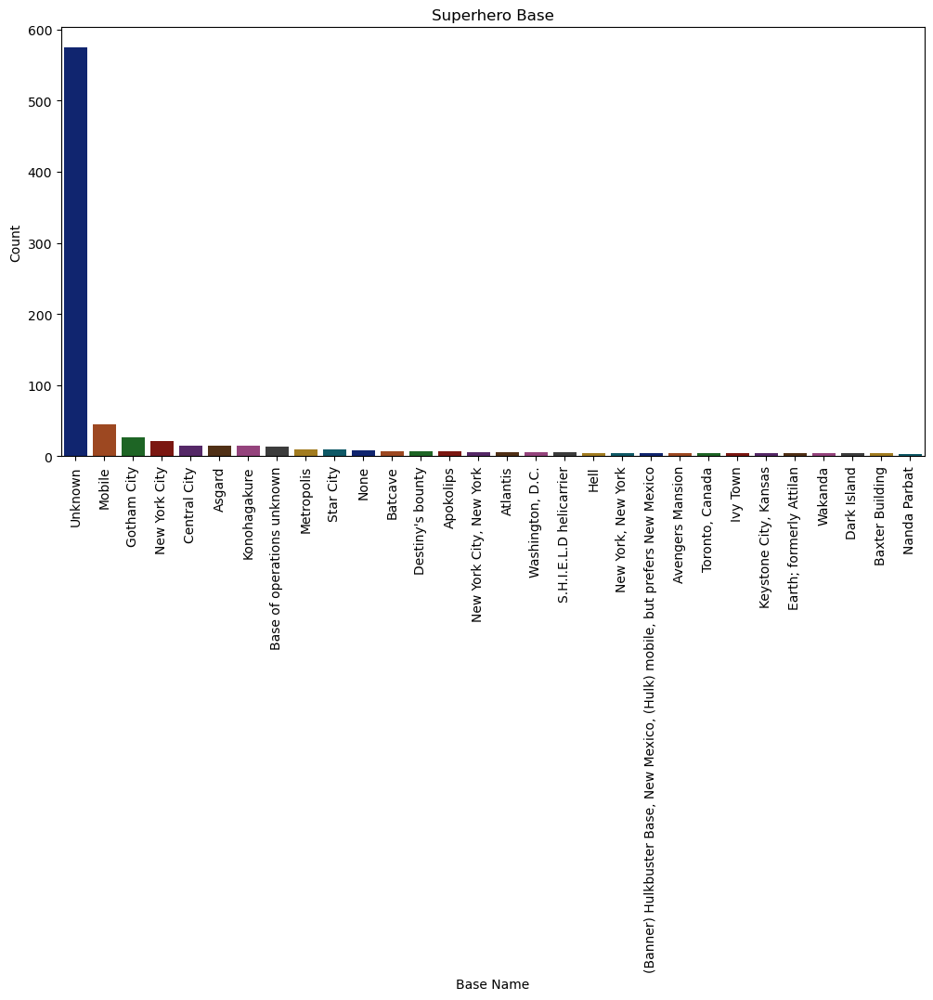

In [92]:
plt.figure(figsize=(12, 6))
sns.barplot(x=bases.index, y=bases.values, palette='dark')
plt.xlabel('Base Name')
plt.ylabel('Count')
plt.title('Superhero Base')
plt.xticks(rotation=90)  
plt.show()

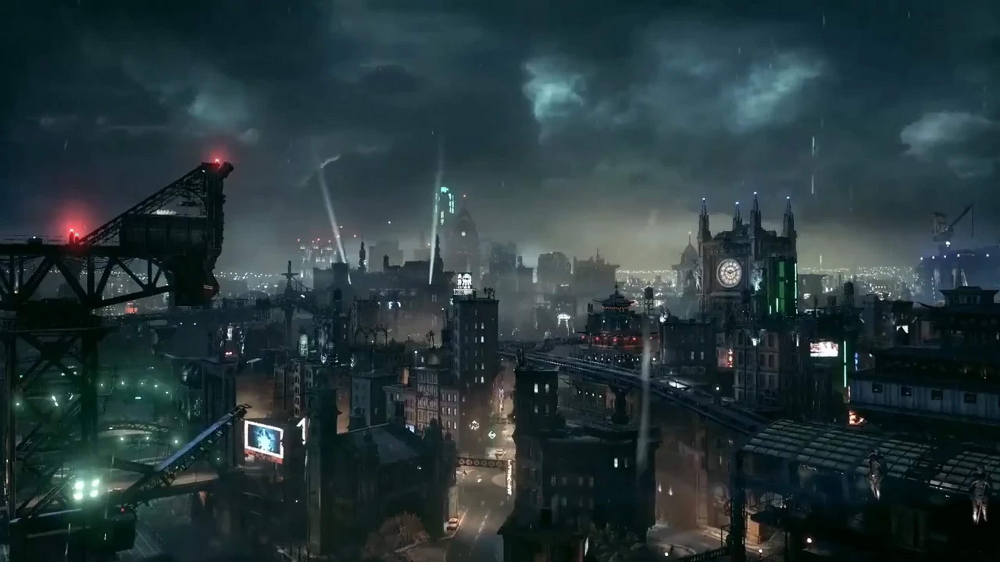

In [93]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Gotham.jpg")

## Top 30 Superheroes Who Has Worked Most Number of Teams

In [36]:
sups['teams_length'] = sups['teams'].apply(len)

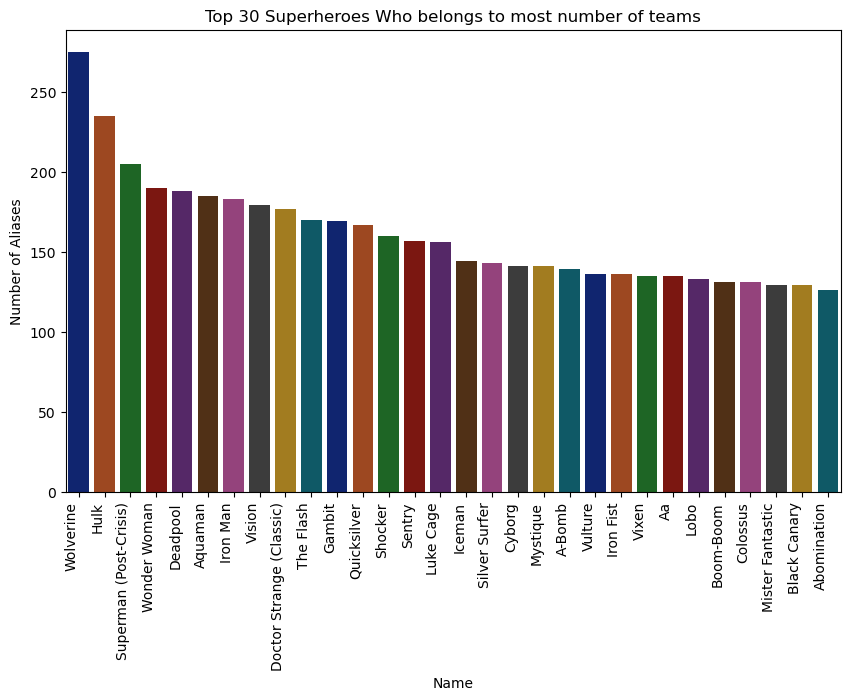

In [37]:
num_of_teams = sups.sort_values(by='teams_length',ascending=False).nlargest(30,columns='teams_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='teams_length', data=num_of_teams, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Aliases')
plt.title('Top 30 Superheroes Who belongs to most number of teams')
plt.xticks(rotation=90, ha='right')
plt.show()

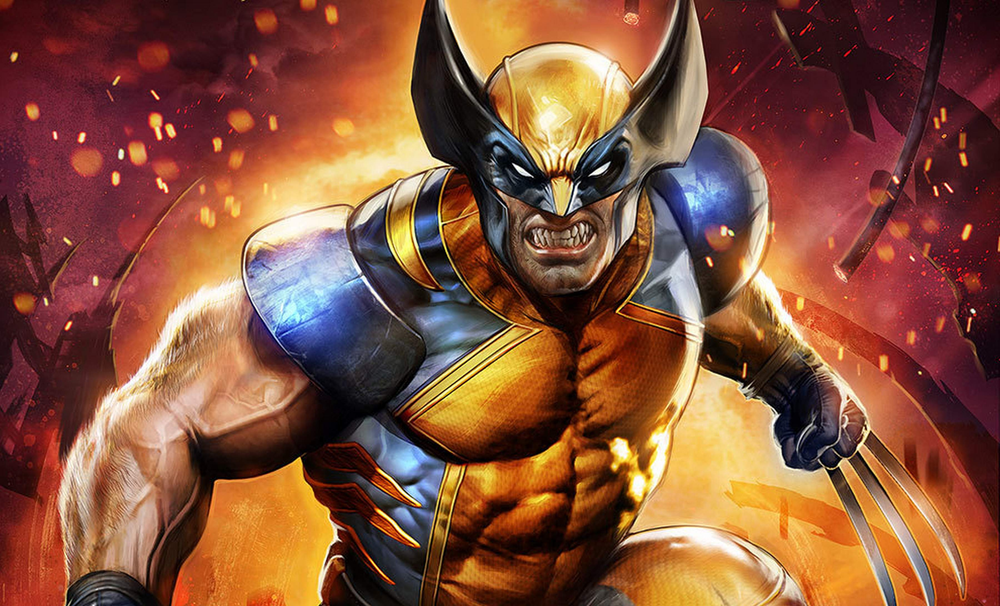

In [94]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\Wolverine.jpg")

## Superhero Orientation

In [95]:
genders = sups['gender'].value_counts()

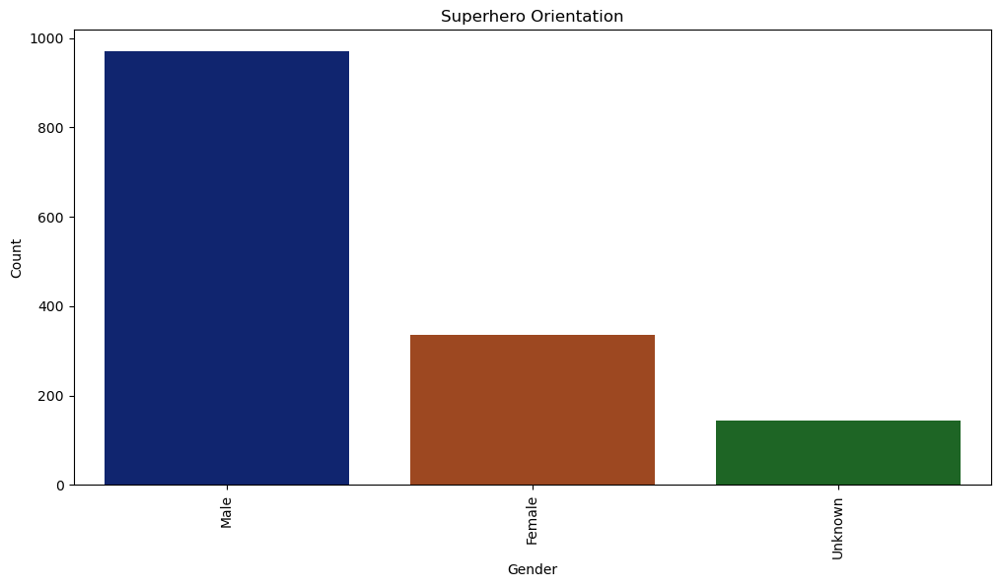

In [96]:
plt.figure(figsize=(12, 6))
sns.barplot(x=genders.index, y=genders.values, palette='dark')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Superhero Orientation')
plt.xticks(rotation=90)  
plt.show()

## Top 30 Superhero Race

In [40]:
races = sups['type_race'].value_counts().nlargest(30)

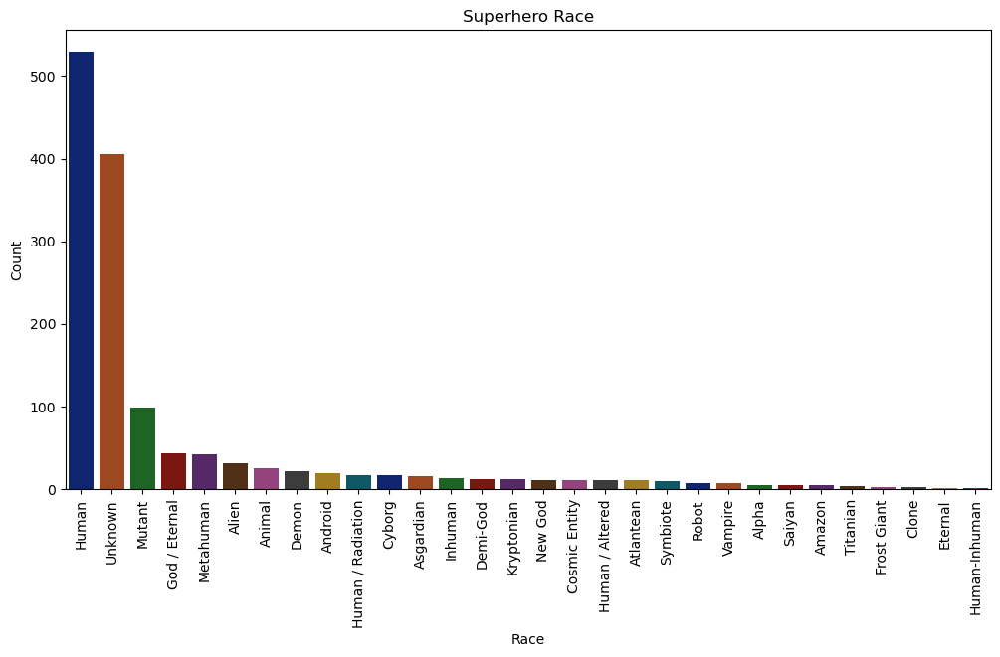

In [41]:
plt.figure(figsize=(12, 6))
sns.barplot(x=races.index, y=races.values, palette='dark')
plt.xlabel('Race')
plt.ylabel('Count')
plt.title('Superhero Race')
plt.xticks(rotation=90)  
plt.show()

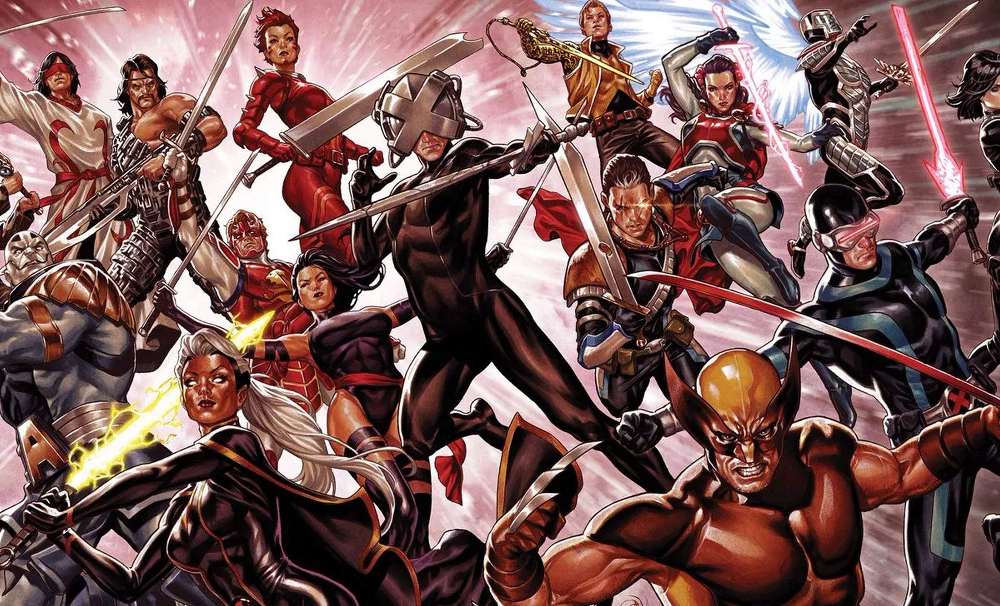

In [97]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\mutants.jpg")

## Height Distribution of Superheroes

In [98]:
height_arr =sups['height(cm)'].unique()

In [99]:
tallest = sups[sups['height(cm)'].isin(height_arr)][['name','height(cm)']].nlargest(30,columns='height(cm)')
tallest = tallest.drop_duplicates(subset=['height(cm)'])


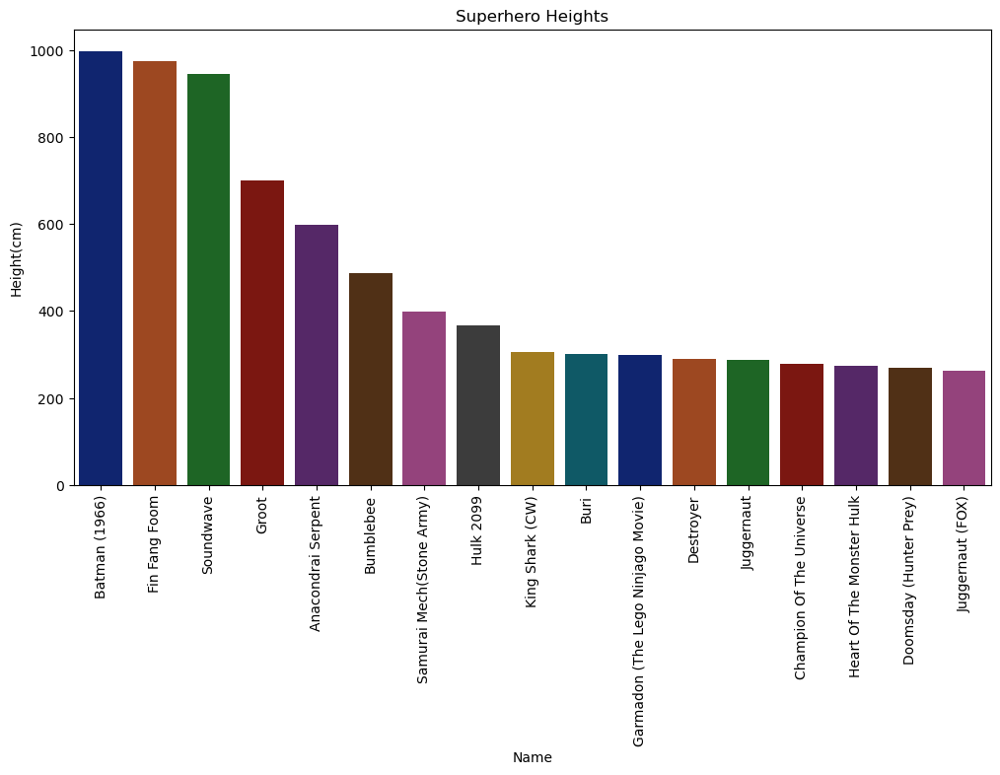

In [44]:
plt.figure(figsize=(12, 6))
sns.barplot(x='name', y='height(cm)', data = tallest, palette='dark')
plt.xlabel('Name')
plt.ylabel('Height(cm)')
plt.title('Superhero Heights')
plt.xticks(rotation=90)  
plt.show()

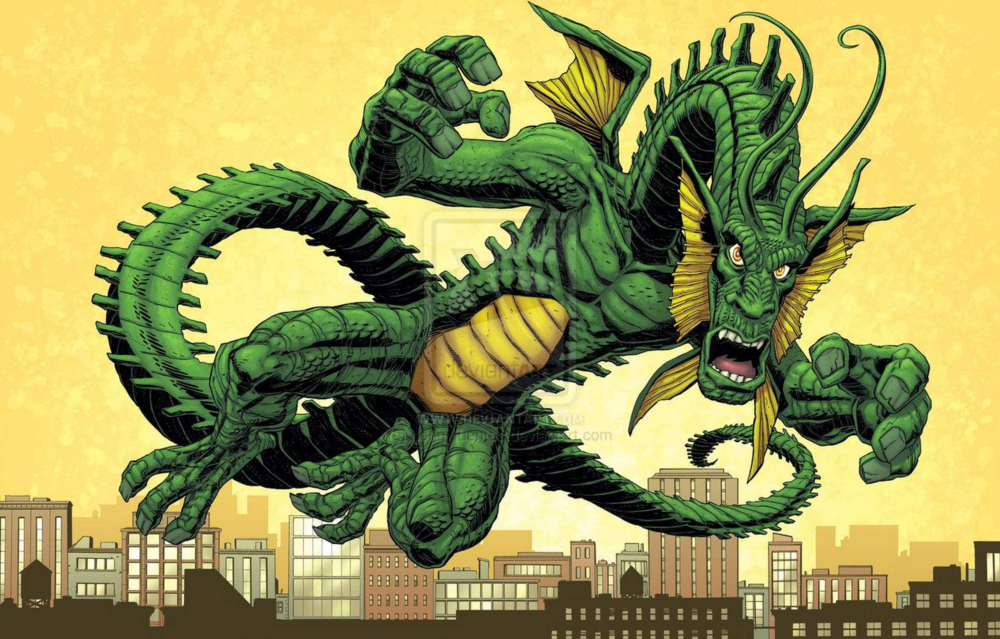

In [100]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\fin_fang_foom.jpg")

## Weight Distribution of Superheroes

In [45]:
weight_arr =sups['weight(lb)'].unique()

In [101]:
Heaviest = sups[sups['weight(lb)'].isin(height_arr)][['name','weight(lb)']].nlargest(30,columns='weight(lb)')
Heaviest = Heaviest.drop_duplicates(subset=['weight(lb)'])

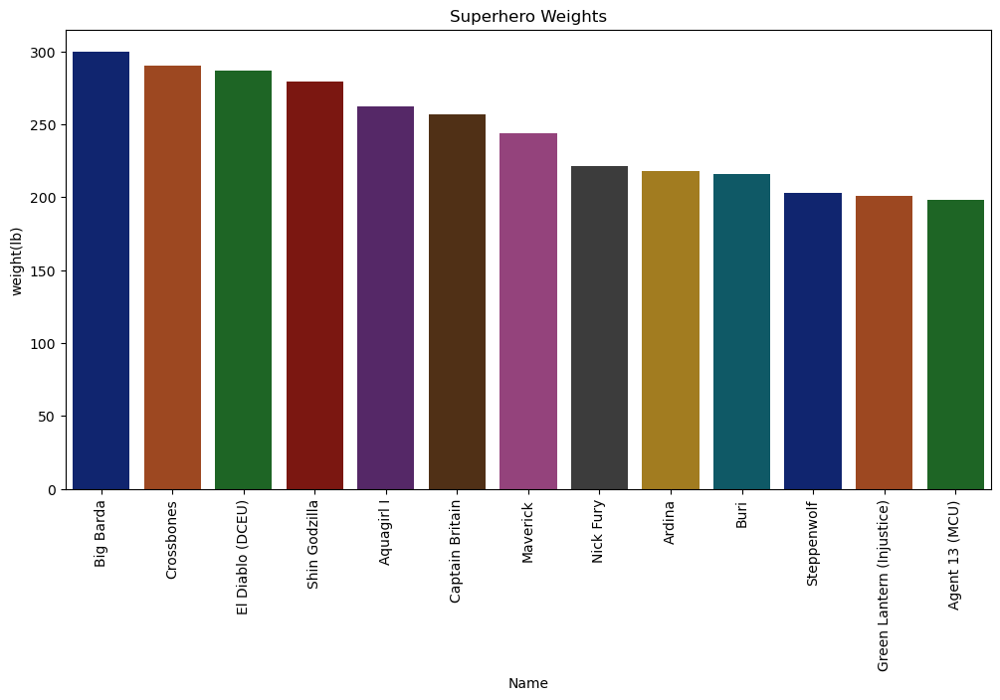

In [47]:
plt.figure(figsize=(12, 6))
sns.barplot(x='name', y='weight(lb)', data = Heaviest, palette='dark')
plt.xlabel('Name')
plt.ylabel('weight(lb)')
plt.title('Superhero Weights')
plt.xticks(rotation=90)  
plt.show()

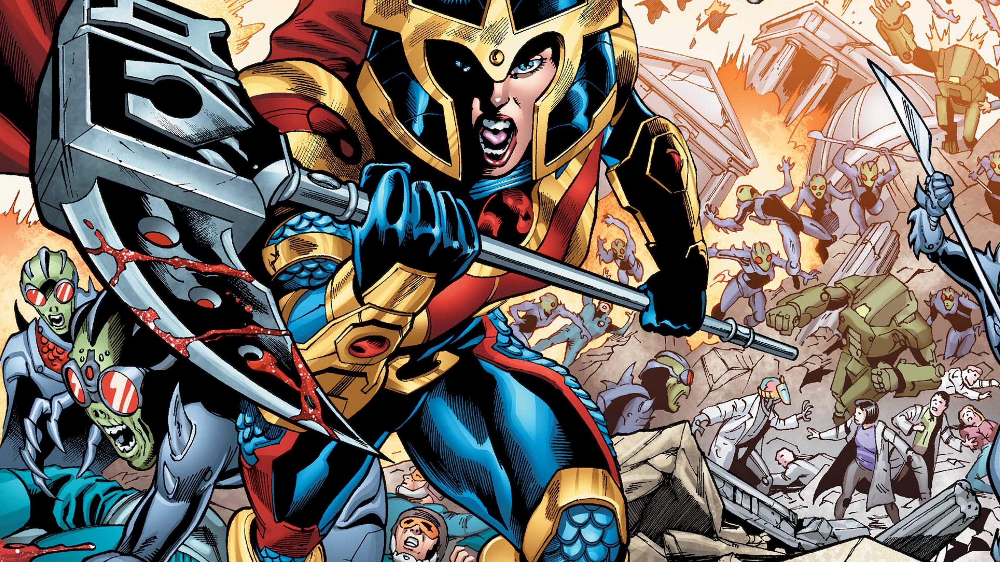

In [102]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\big_barda.jpg")

## Eye color distribution of Superheroes|

In [66]:
eye_arr =sups['eye_color'].value_counts().nlargest(30)

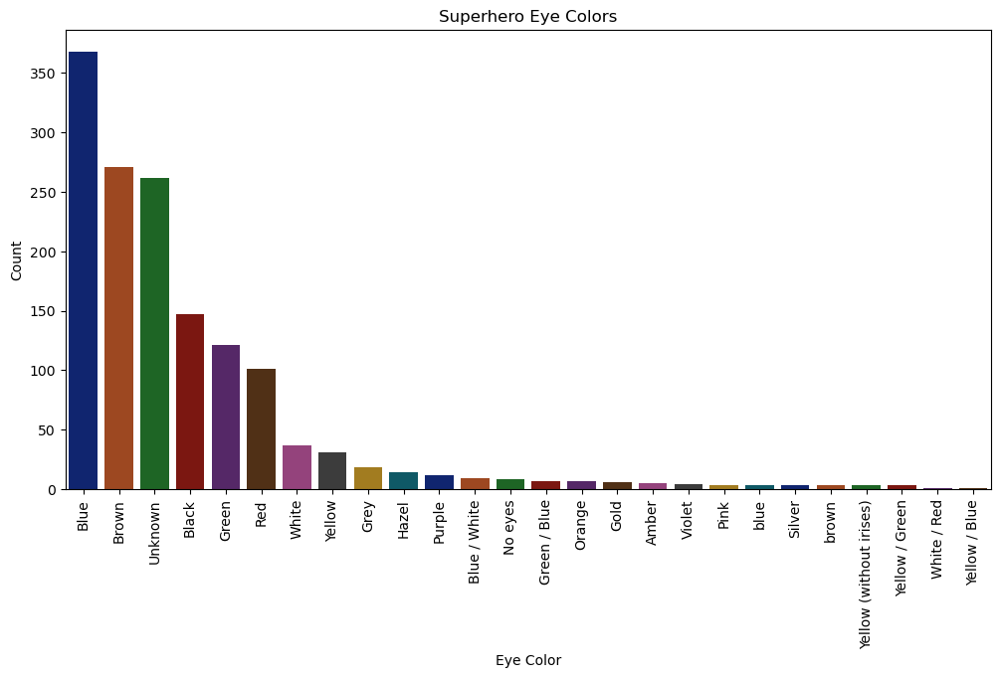

In [49]:
plt.figure(figsize=(12, 6))
sns.barplot(x=eye_arr.index, y=eye_arr.values, palette='dark')
plt.xlabel('Eye Color')
plt.ylabel('Count')
plt.title('Superhero Eye Colors')
plt.xticks(rotation=90)  
plt.show()

## Hair Color Distribution

In [67]:
Hair_arr =sups['hair_color'].value_counts().nlargest(30)

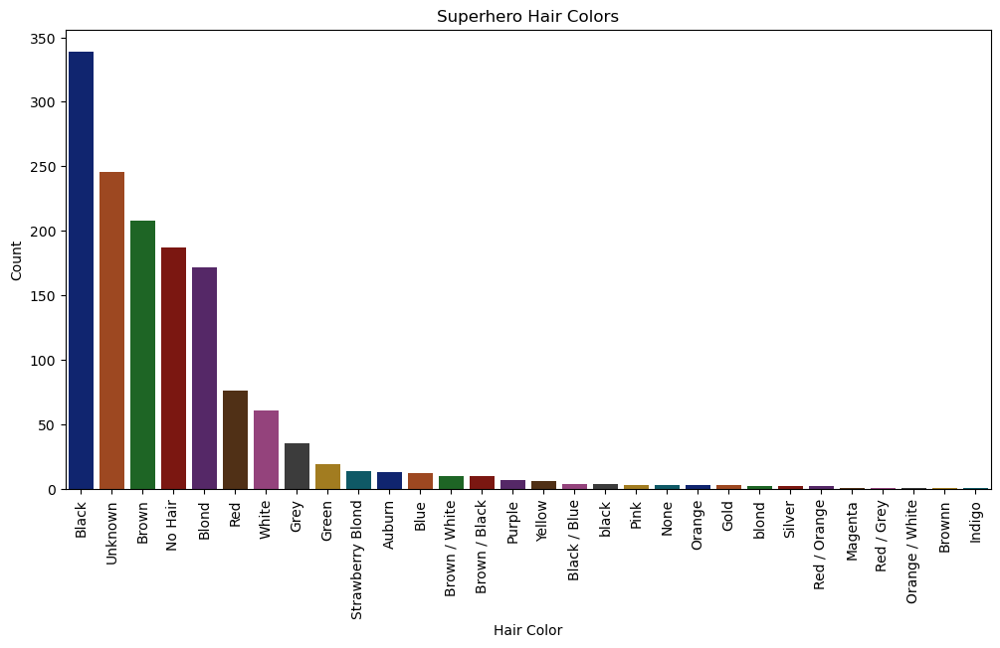

In [51]:
plt.figure(figsize=(12, 6))
sns.barplot(x=Hair_arr.index, y=Hair_arr.values, palette='dark')
plt.xlabel('Hair Color')
plt.ylabel('Count')
plt.title('Superhero Hair Colors')
plt.xticks(rotation=90)  
plt.show()

In [52]:
skin_arr =sups['skin_color'].value_counts().nlargest(30)

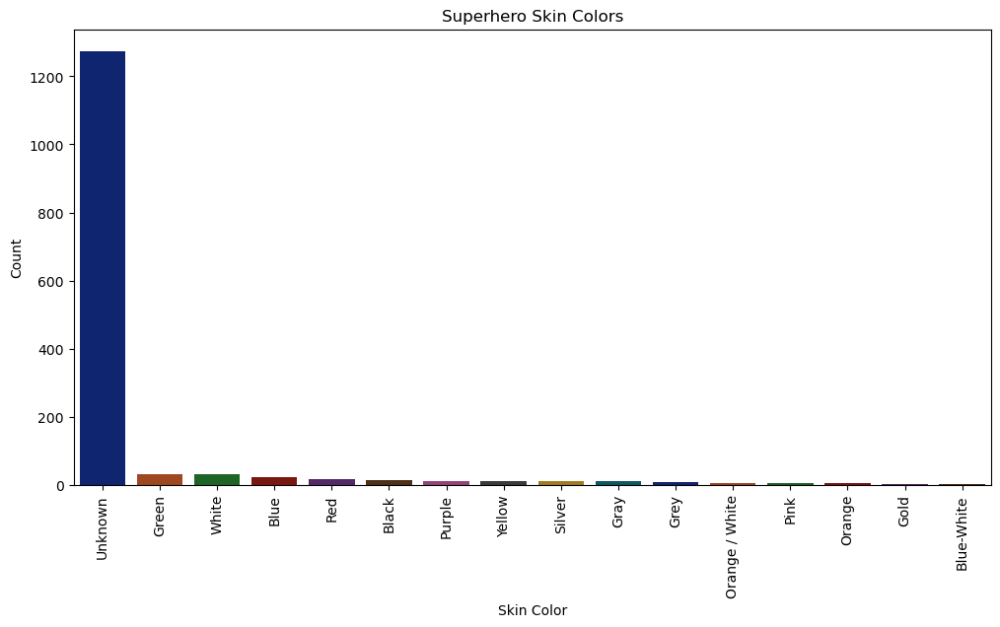

In [53]:
plt.figure(figsize=(12, 6))
sns.barplot(x=skin_arr.index, y=skin_arr.values, palette='dark')
plt.xlabel('Skin Color')
plt.ylabel('Count')
plt.title('Superhero Skin Colors')
plt.xticks(rotation=90)  
plt.show()

## Superheroes Who got the most physical abilities

In [54]:
arr = [
    "has_super_strength", 
    "has_peak_human_condition",
    "has_super_speed",
    "has_reflexes",
    "has_durability", 
    "has_invulnerability",
    "has_agility", 
    "has_dexterity"
]

filtered_rows_physical = sups[sups[arr].all(axis=1)].sort_values(by=["has_super_strength", 
    "has_peak_human_condition",
    "has_super_speed",
    "has_reflexes",
    "has_durability", 
    "has_invulnerability",
    "has_agility", 
    "has_dexterity"],ascending=False)  # this is checking if all the columns are true for which rows. That are getting filltered

filtered_rows_physical = filtered_rows_physical.sort_values(by='overall_score',ascending=False)

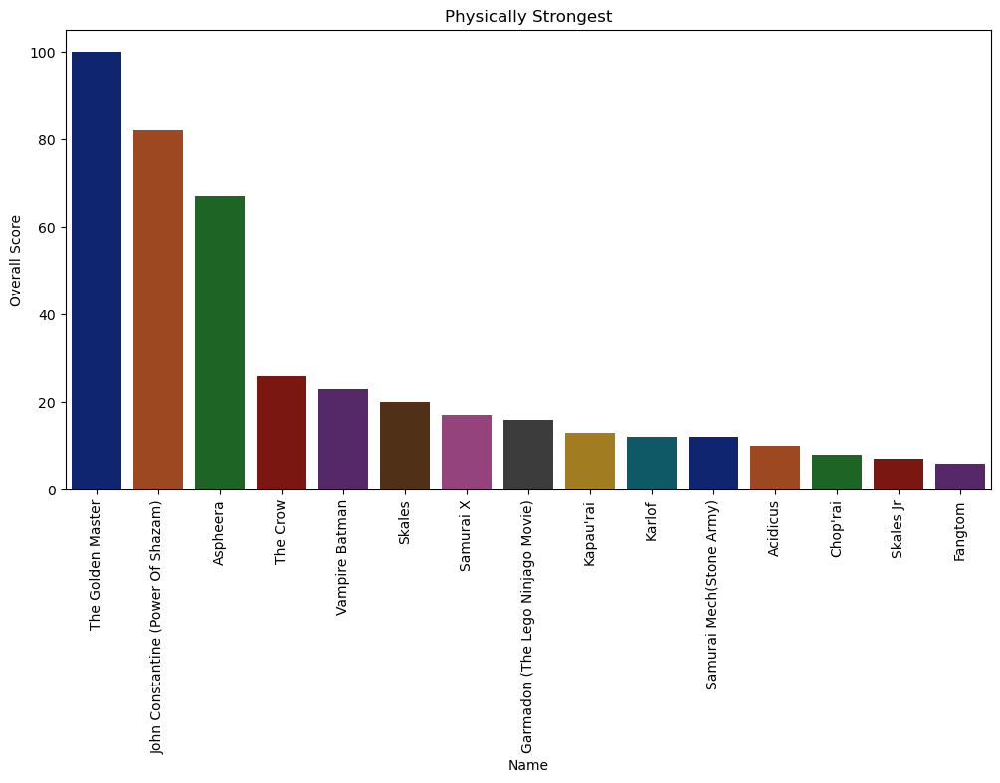

In [55]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_physical['name'], y=filtered_rows_physical['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Physically Strongest')
plt.xticks(rotation=90)  
plt.show()

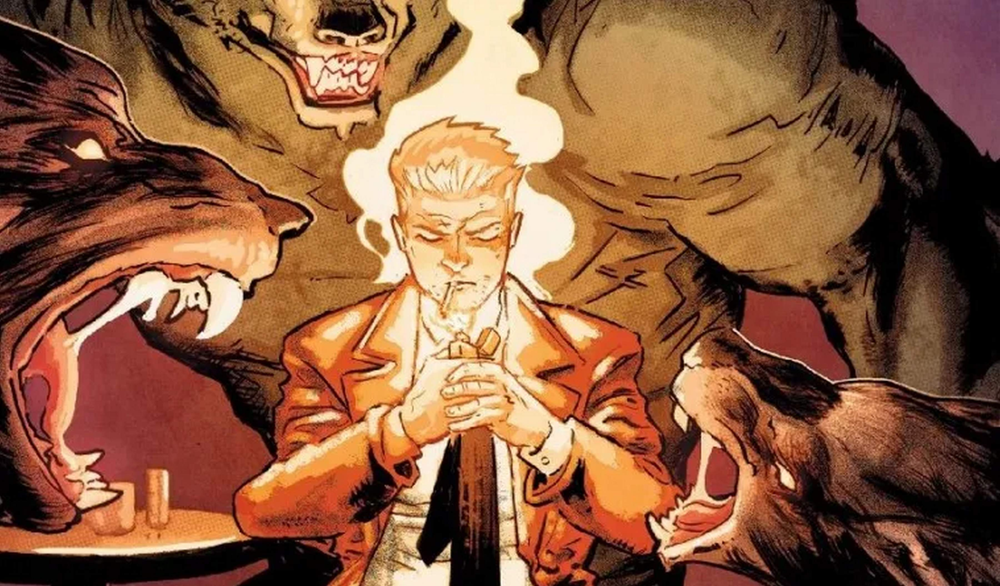

In [103]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\john_constantine.jpg")

## Experts in Mind Control

In [56]:
# Assuming your DataFrame is named 'sups'
mind_control_power = [
    "has_telepathy", 
    "has_telepathy_resistance",
    "has_telekinesis",
    "has_mind_control", 
    "has_mind_control_resistance"
]

filtered_rows_mind = sups[sups[mind_control_power].all(axis=1)].sort_values(by=["has_telepathy", 
    "has_telepathy_resistance",
    "has_telekinesis",
    "has_mind_control", 
    "has_mind_control_resistance"],ascending=False)  # this is checking if all the columns are true for which rows. That are getting filltered

filtered_rows_mind = filtered_rows_mind.sort_values(by='overall_score',ascending=False)

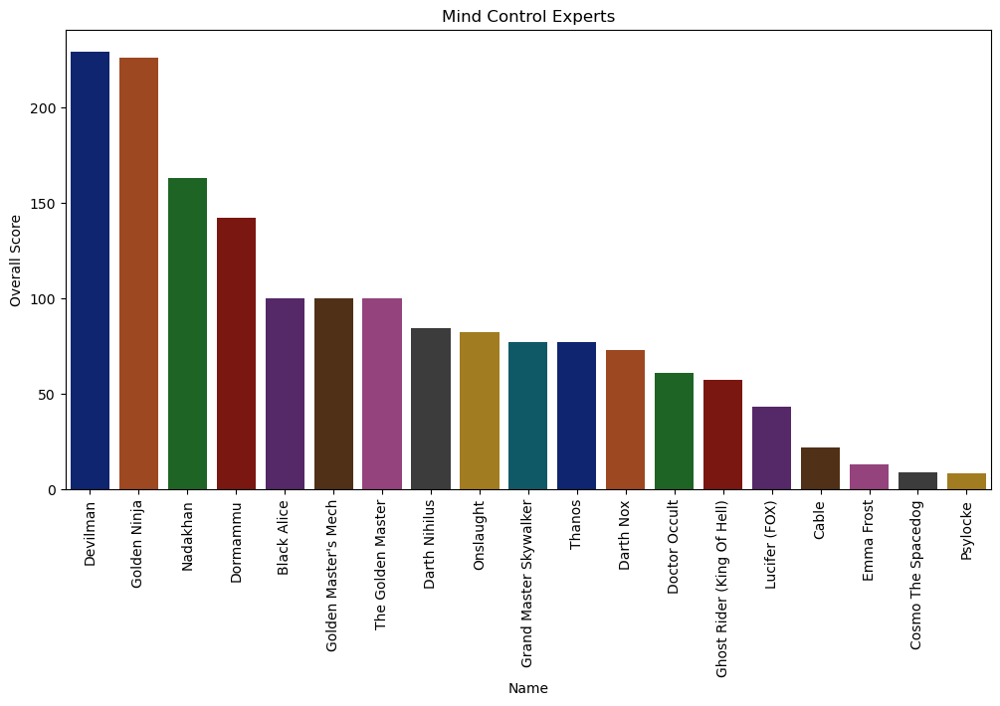

In [57]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_mind['name'], y=filtered_rows_mind['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Mind Control Experts')
plt.xticks(rotation=90)  
plt.show()

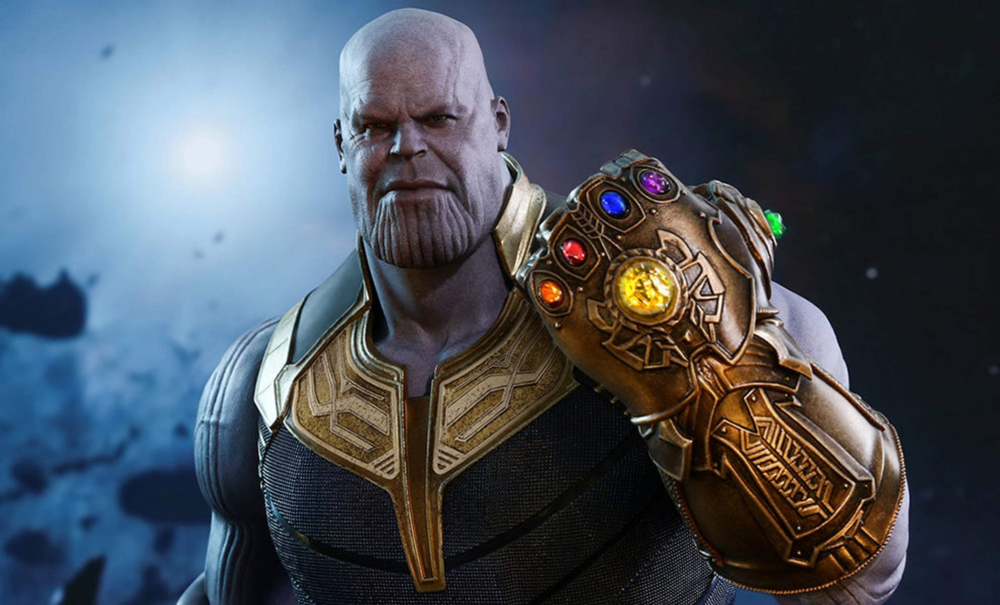

In [104]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\thanos.jpg")

## Experts in Energy Manipulation

In [58]:
arr = [
    "has_energy_beams",
    "has_energy_constructs",
    "has_energy_manipulation", 
    "has_energy_absorption"
]


filtered_rows_energy = sups[sups[arr].all(axis=1)].sort_values(by=arr,ascending=False)  # this is checking if all the columns are true for which rows. That are getting filltered
filtered_rows_energy = filtered_rows_energy.sort_values(by='overall_score',ascending=False)

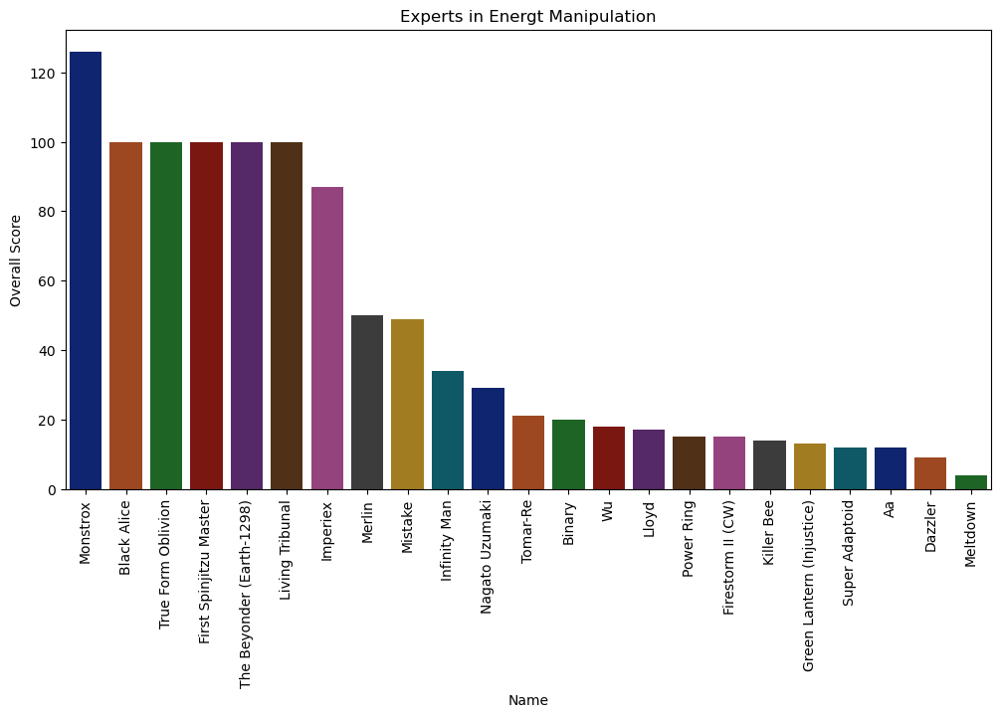

In [59]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_energy['name'], y=filtered_rows_energy['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Experts in Energt Manipulation')
plt.xticks(rotation=90)  
plt.show()

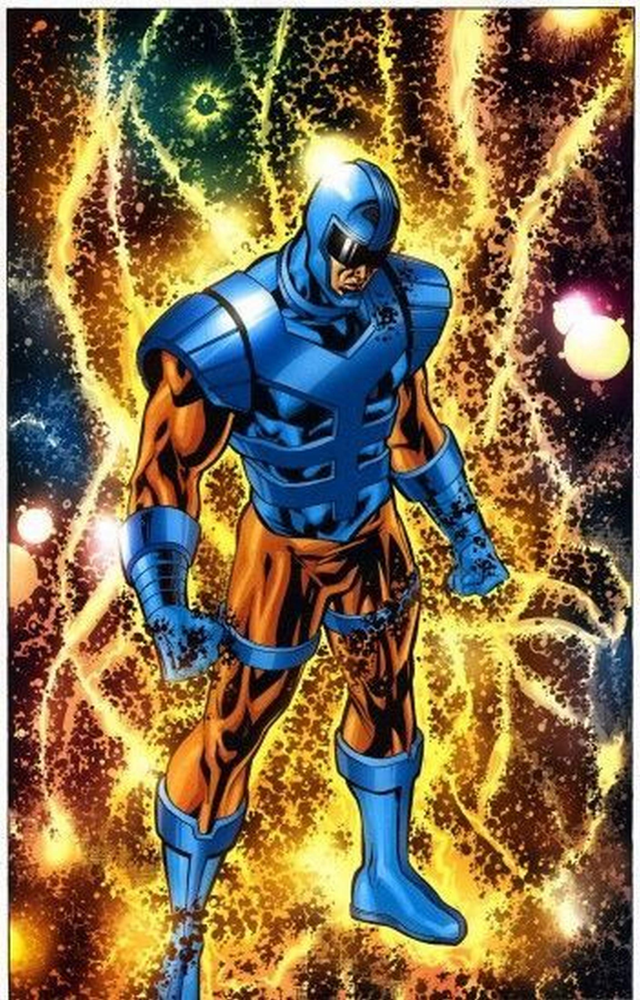

In [106]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\infinity.jpg")

## Experts in Elemental Abilities

In [60]:
arr = [
    "has_fire_control",
    "has_cold_resistance",
    "has_element_control",
    'has_fire_resistance',
    'has_reality_warping',
    'has_heat_resistance',
    'has_energy_absorption',
    'has_cold_resistance',
    'has_energy_manipulation'
    
]

filtered_rows_element = sups[sups[arr].all(axis=1)].sort_values(by=arr,ascending=False).nlargest(columns=arr,n=30)  # this is checking if all the columns are true for which rows. That are getting filltered
filtered_rows_element = filtered_rows_element.sort_values(by='overall_score',ascending=False)

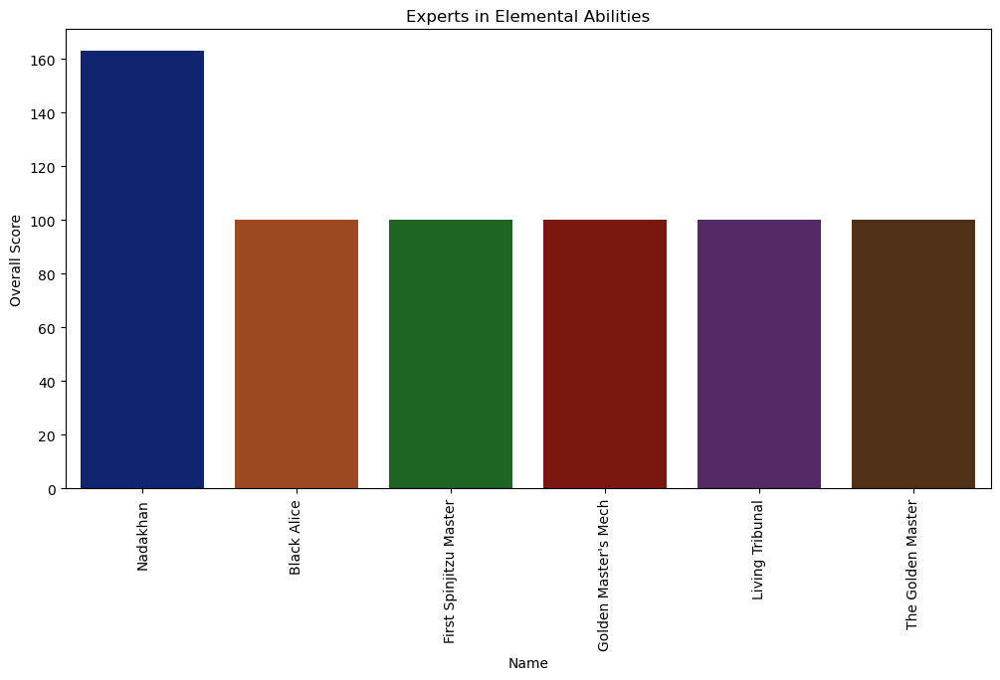

In [61]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_element['name'], y=filtered_rows_element['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Experts in Elemental Abilities')
plt.xticks(rotation=90)  
plt.show()

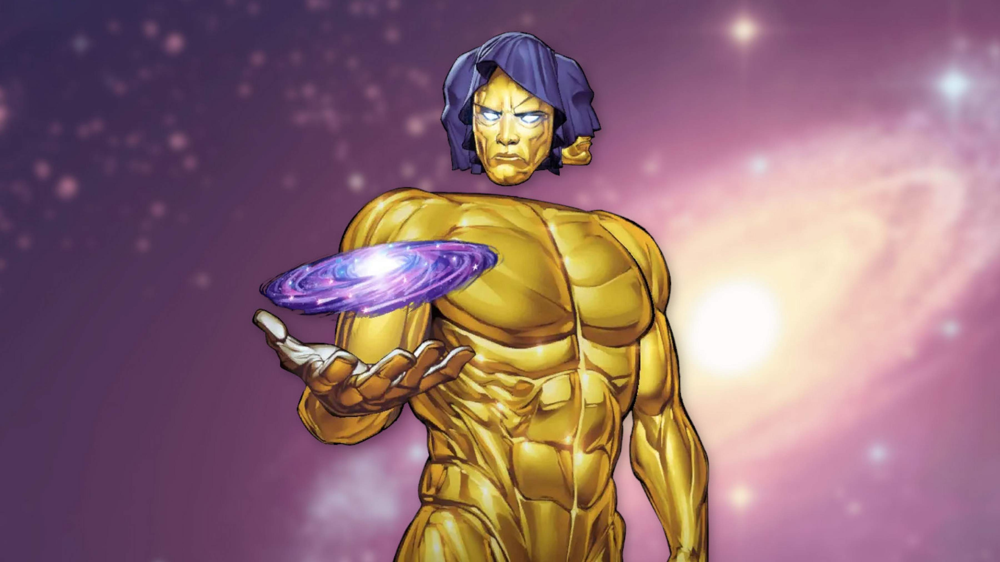

In [107]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\living_tribunal.jpg")

## Weapon Masters

In [62]:
arr = [
    "has_weapons_master",
    "has_marksmanship",
    "has_stealth",
    "has_accelerated_healing"
    
]

filtered_rows_weapon = sups[sups[arr].all(axis=1)].sort_values(by=arr,ascending=False).nlargest(columns='overall_score',n=30)  
# this is checking if all the columns are true for which rows. That are getting filltered
filtered_rows_weapon = filtered_rows_weapon.sort_values(by='overall_score',ascending=False)

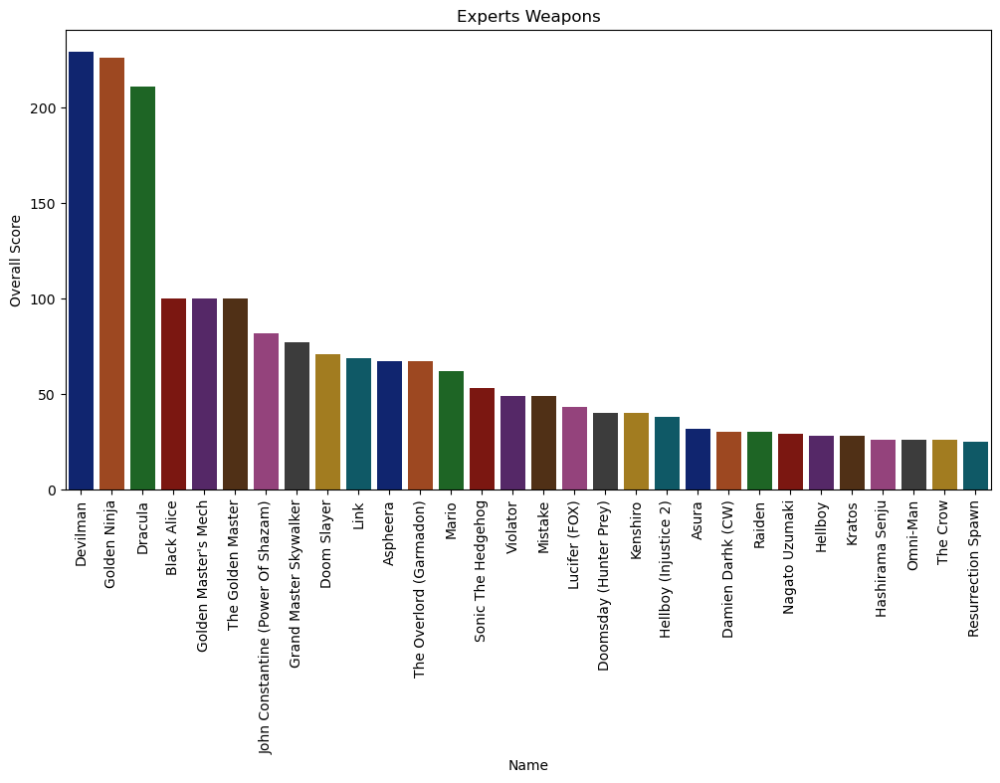

In [63]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_weapon['name'], y=filtered_rows_weapon['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Experts Weapons')
plt.xticks(rotation=90)  
plt.show()

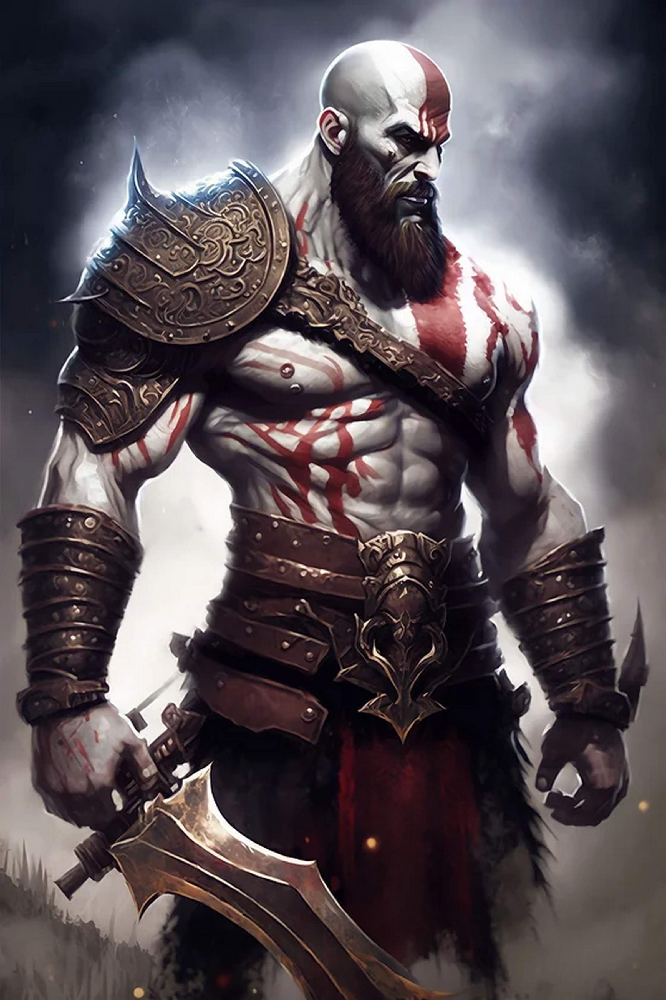

In [108]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\kratos.jpg")

## Technical Experts

In [64]:
arr = ['has_fire_control','has_energy_beams',
       'has_cold_resistance','has_energy_blasts',
       'has_flight','has_weapons_master',
       'has_intelligence',
       'has_super_speed',
       'has_super_strength'
       ]

filtered_rows_tech = sups[sups[arr].all(axis=1)].sort_values(by=arr,ascending=False)  # this is checking if all the columns are true for which rows. That are getting filltered
filtered_rows_tech = filtered_rows_tech.sort_values(by='overall_score',ascending=False)
filtered_rows_tech

,name,overall_score,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,alter_egos,aliases,place_of_birth,first_appearance,creator,alignment,occupation,base,teams,gender,type_race,height(cm),weight(lb),eye_color,hair_color,skin_color,has_electrokinesis,has_energy_constructs,has_mind_control_resistance,has_matter_manipulation,has_telepathy_resistance,has_mind_control,has_enhanced_hearing,has_dimensional_travel,has_element_control,has_size_changing,has_fire_resistance,has_fire_control,has_dexterity,has_reality_warping,has_illusions,has_energy_beams,has_peak_human_condition,has_shapeshifting,has_heat_resistance,has_jump,has_self-sustenance,has_energy_absorption,has_cold_resistance,has_magic,has_telekinesis,has_toxin_and_disease_resistance,has_telepathy,has_regeneration,has_immortality,has_teleportation,has_force_fields,has_energy_manipulation,has_endurance,has_longevity,has_weapon-based_powers,has_energy_blasts,has_enhanced_senses,has_invulnerability,has_stealth,has_marksmanship,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength,superpower_length,alter_ego_length,aliases_length,teams_length
932,Nadakhan,163,95,75,85,100,100,75,"['Ability Shift', 'Absorption', 'Accelerated H...",[],[''],Djinjago,Infamous/ 70605 Misfortune's Keep,Unknown,Bad,Leader Of The Sky Pirates.,Djinjago,[],Male,Unknown,183.14,287.00,Black,Black,Unknown,False,False,True,False,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,1361,2,4,2
480,First Spinjitzu Master,100,100,100,100,100,100,100,"['Absorption', 'Acausality', 'Accelerated Heal...","['Heavy (Team Fortress 2)', 'Iron Baron', 'Yur...",['None'],The realm of oni and dragons,Way of the Ninja (Pictured),Unknown,Good,Creator,None,[],Male,God / Eternal,178.00,132.00,Amber,White,Yellow,True,True,True,True,False,True,False,True,True,False,True,True,True,True,True,True,False,True,True,False,True,True,True,False,True,True,True,True,False,True,True,True,True,True,False,True,True,True,False,False,True,True,True,True,True,True,True,True,True,True,1523,55,8,2
1279,The Golden Master,100,100,100,100,100,100,100,"['Absorption', 'Accelerated Healing', 'Agility...","[""Golden Master's Mech"", 'The Overlord', 'The ...","['Overlord,Dark lord']",Ninjago,"The Curse of the Golden Master Season 3, Episo...",Unknown,Bad,Leader Of The Nindroids.,Mobile,[],Male,God / Eternal,198.00,209.93,Red,No Hair,Black,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,1692,67,22,2
613,Hulk (Stark Gauntlet) (MCU),47,100,100,80,100,100,90,"['Absorption', 'Accelerated Healing', 'Agility...","['Bruce Banner', 'Bruce Banner (Hulkbuster) (M...","['Hulk, Bruce Banner']",Unknown,Avengers: Endgame,Marvel Comics,Good,Avenger,Unknown,[],Male,Human,183.14,209.93,Green,Black,Unknown,False,False,False,True,False,False,False,False,False,False,False,True,False,True,True,True,False,False,True,True,False,True,True,False,True,True,True,False,False,True,True,True,False,True,False,True,True,False,False,False,True,True,True,True,True,True,True,True,True,True,702,674,22,2
645,Iron Man (MCU),13,100,80,55,80,90,70,"['Audio Control', 'Cold Resistance', 'Energy B...","['Igor', 'Iron Boy', 'Iron Destroyer', 'Iron M...",['Billionaire Playboy Philanthropist'],Unknown,Iron Man (2008),Marvel Comics,Good,Unknown,Unknown,['Avengers'],Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,Fa

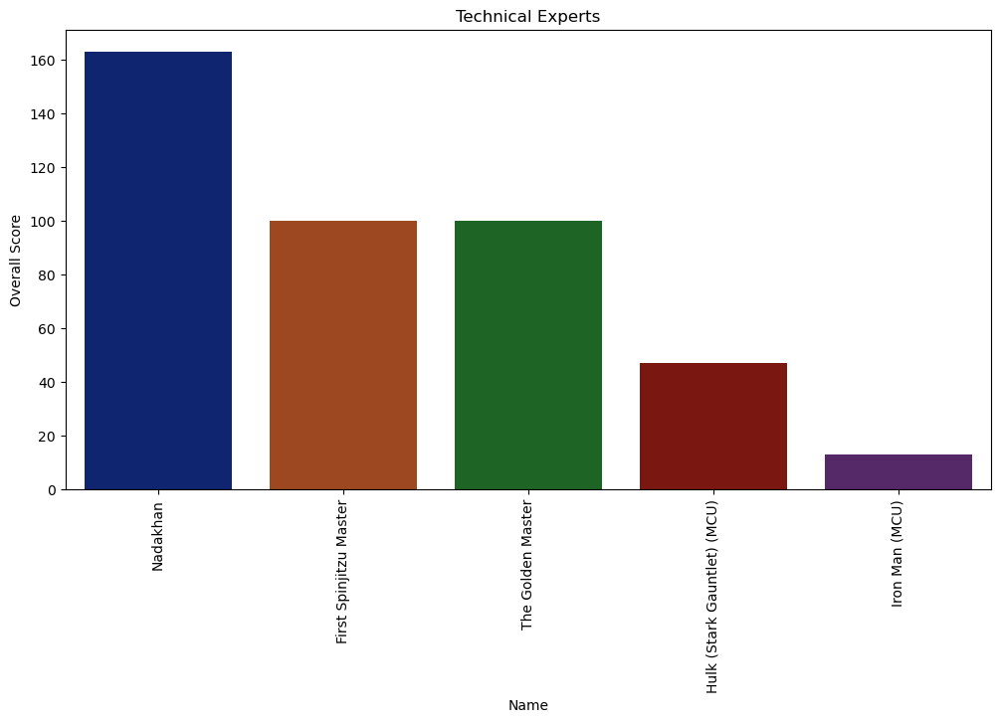

In [65]:
plt.figure(figsize=(12, 6))
sns.barplot(x=filtered_rows_tech['name'], y=filtered_rows_tech['overall_score'], palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Technical Experts')
plt.xticks(rotation=90)  
plt.show()

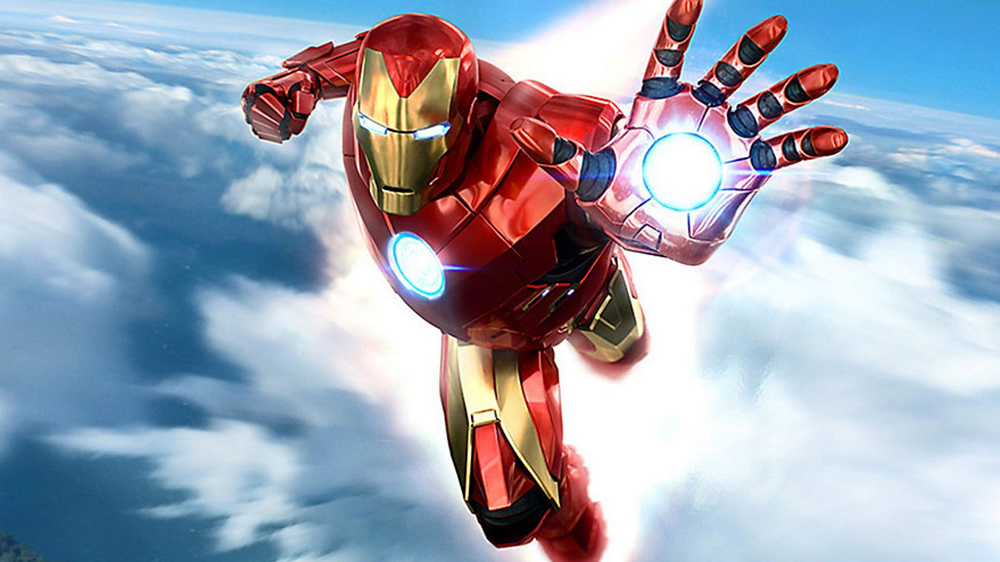

In [109]:
from IPython import display
display.Image("C:\\Games\\Sups Pictures\\ironman_lastone.jpg")